In [7]:
import os, glob, csv, bz2, pickle

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import matplotlib as mpl


from itertools import combinations
import itertools

from time import time
from matplotlib import rc

from sklearn.metrics import confusion_matrix, jaccard_score, f1_score, accuracy_score, balanced_accuracy_score

# # #rc('font',**{'family':'sans-serif','sans-serif':['Helvetica']})
# rc('font',**{'family':'serif','serif':['Computer Modern']})
# rc('text', usetex = True)

plt.rcParams['axes.facecolor'] = 'silver'

# Aggregated-Level Extremality Detection

In [8]:
# This is the path to data (stract inside Sim* files)
path_to_data   = r"/Users/Guille/Desktop/extreme_scenarios/data/"
path_to_data   = r"/Users/Guille/Dropbox/ProcessedDataTexas/vatic_output/Texas-7k/FunctionalDepthsTexas/"

path_to_images = r"/Users/Guille/Desktop/extreme_scenarios/images/depth/"
path_to_scen   = r'/Users/Guille/Desktop/extreme_scenarios/scenarios/clnSim/'
path_to_vatic  = r'/Users/Guille/Desktop/extreme_scenarios/outputs/Texas-7k/'

        
#metrics_ = ['Band Depth', 'Modified Band Depth', 'Directional Quantile', 'Extremal Depth', 'L$_\infty$ Depth', 
#            'Extreme Rank Length Depth', '$h$-Mode Depth', 'Random Tukey Depth', 'Integrated Depth', 'Random Projection Depth']

metrics_ = ['BD', 'MBD', 'DQ', 'ED', 'L$_\infty$D', 'ERLD', '$h$D', 'RTD', 'ID', 'RPD']

dates_ = ['2018-02-14', '2018-02-13', '2018-08-08', '2018-06-04', '2018-05-25',
          '2018-11-13', '2018-09-14', '2018-04-24', '2018-05-10', '2018-04-01',
          '2018-12-27', '2018-04-09', '2018-07-22', '2018-07-24', '2018-03-14',
          '2018-01-02', '2018-06-30', '2018-02-26', '2018-12-01', '2018-10-17',
          '2018-11-02', '2018-10-02', '2018-09-04', '2018-08-18', '2018-01-20']

features_ = ['Load', 'Solar Generation', 'Wind Generation', 'Renewable Energy Generation', 'Net Load']
vatic_    = ['Variable Costs', 'Load Shedding', 'Renewable Energy Curtailment', 'Reserve Shortfall']

## Load Processed Vatic and Scenarios Data

In [27]:
with open(path_to_data + 'ProcessedAggregatedData.pkl', 'rb') as handle:
    aggData_ = pickle.load(handle)
    
L_ = aggData_[0]
S_ = aggData_[1]
W_ = aggData_[2]
G_ = aggData_[3]
N_ = aggData_[4]
Y_ = aggData_[5]
X_ = [L_, S_, W_, G_, N_]
print(L_.shape, S_.shape, W_.shape, G_.shape, N_.shape, Y_.shape)

with open(path_to_data + 'AreaFuntionalDepths.pkl', 'rb') as handle:
    aggFunAUC_ = pickle.load(handle)

with open(path_to_data + 'DiffFuntionalDepths.pkl', 'rb') as handle:
    aggFunDiff_ = pickle.load(handle)
print(aggFunAUC_.shape, aggFunDiff_.shape)

N_metrics, N_features, N_days, N_scenarios = aggFunAUC_.shape
print(N_metrics, N_features, N_days, N_scenarios)

idx_plot_ = []
for i in range(2):
    for j in range(5):
        idx_plot_.append((i, j))

idx_dates_ = np.argsort(dates_)
dates_     = np.array(dates_)[idx_dates_]
print(dates_)

(1000, 24, 25) (1000, 24, 25) (1000, 24, 25) (1000, 24, 25) (1000, 24, 25) (1000, 4, 25)
(10, 5, 25, 1000) (10, 5, 25, 1000)
10 5 25 1000
['2018-01-02' '2018-01-20' '2018-02-13' '2018-02-14' '2018-02-26'
 '2018-03-14' '2018-04-01' '2018-04-09' '2018-04-24' '2018-05-10'
 '2018-05-25' '2018-06-04' '2018-06-30' '2018-07-22' '2018-07-24'
 '2018-08-08' '2018-08-18' '2018-09-04' '2018-09-14' '2018-10-02'
 '2018-10-17' '2018-11-02' '2018-11-13' '2018-12-01' '2018-12-27']


## Aggregated Extreme Variable Cost Detection

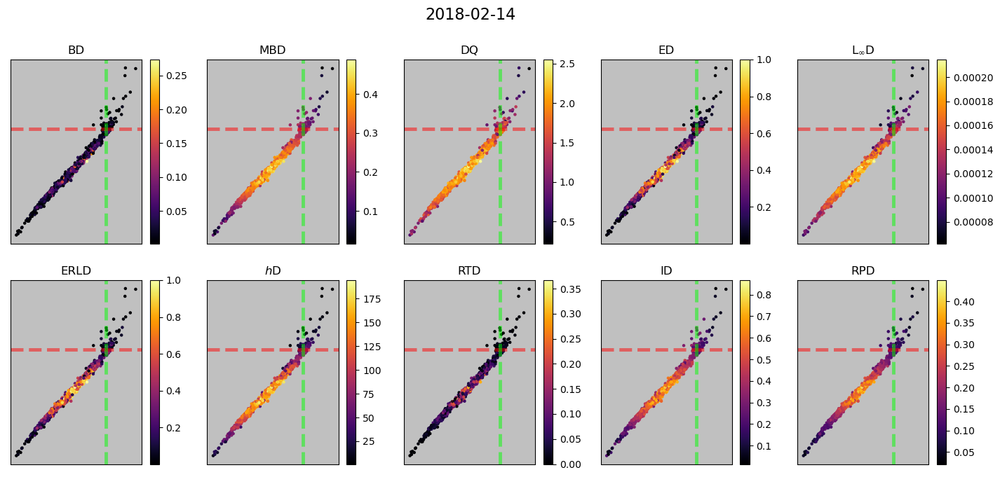

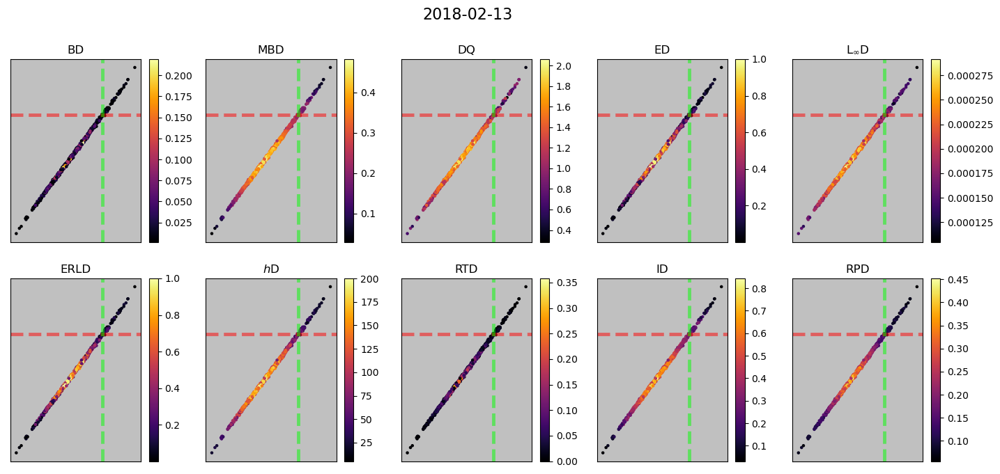

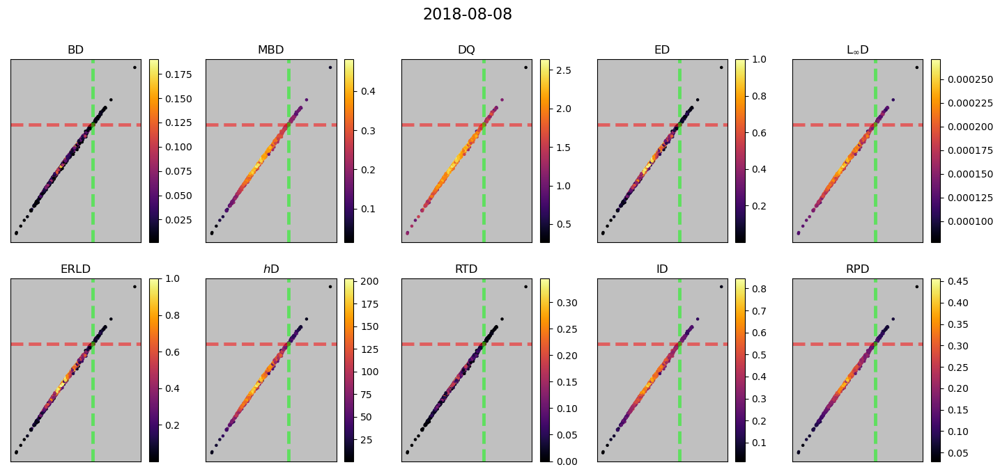

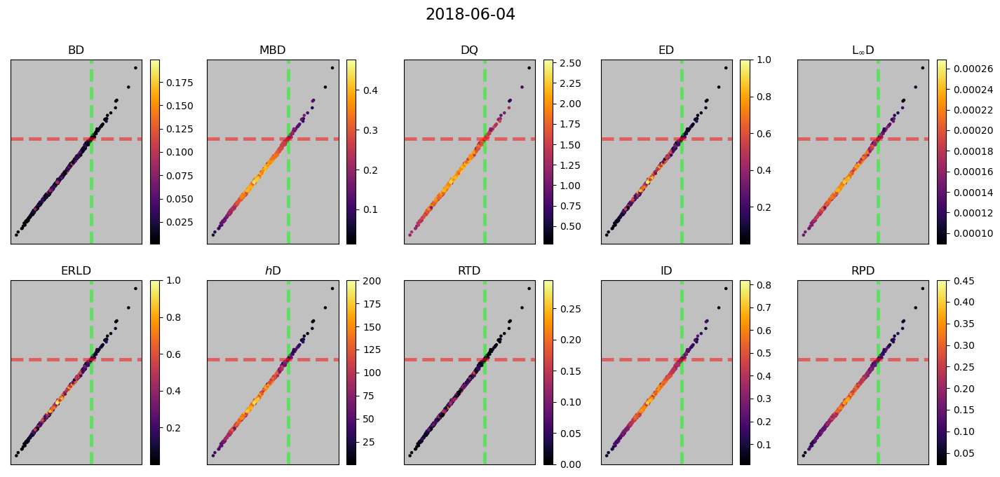

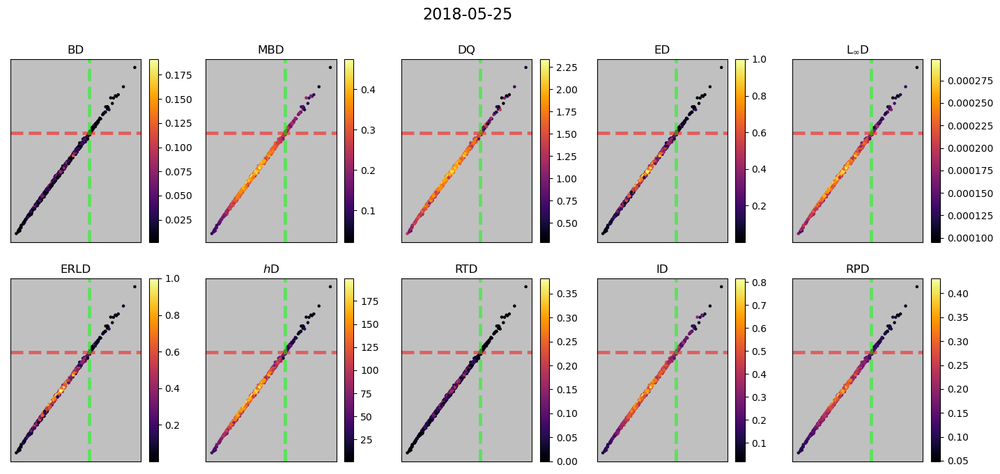

...

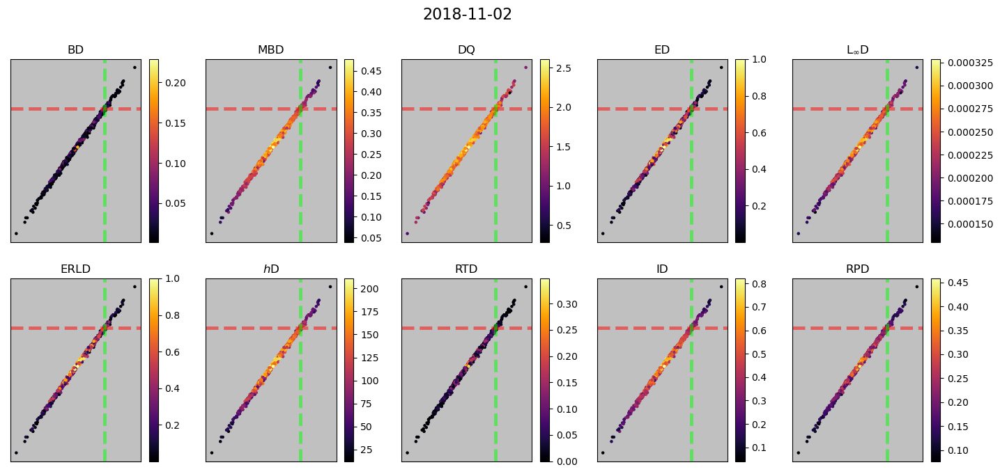

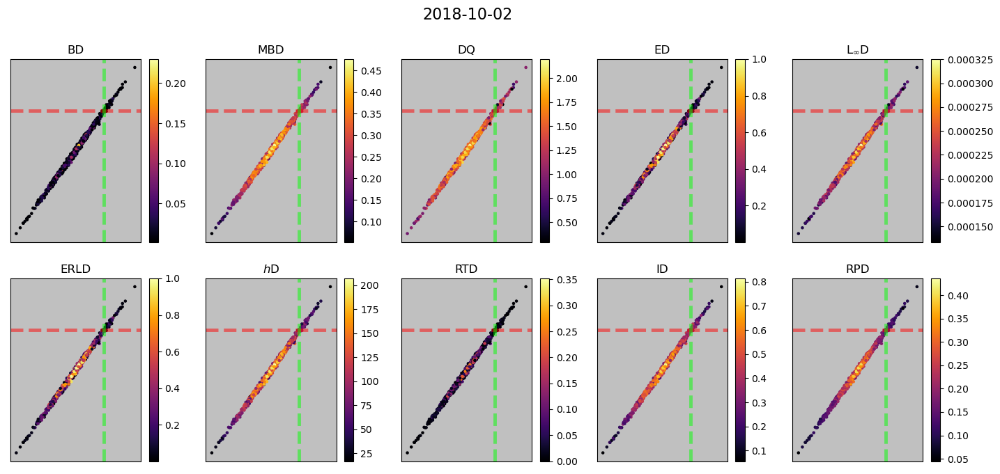

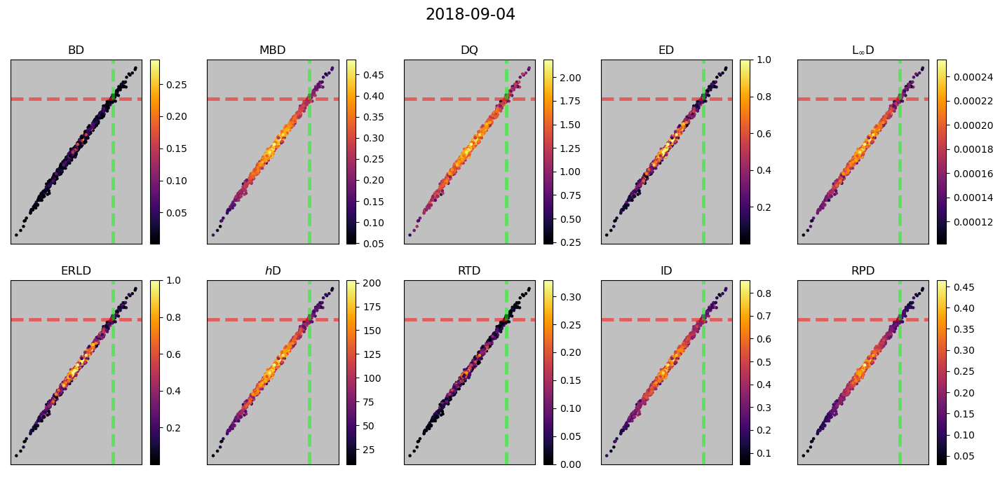

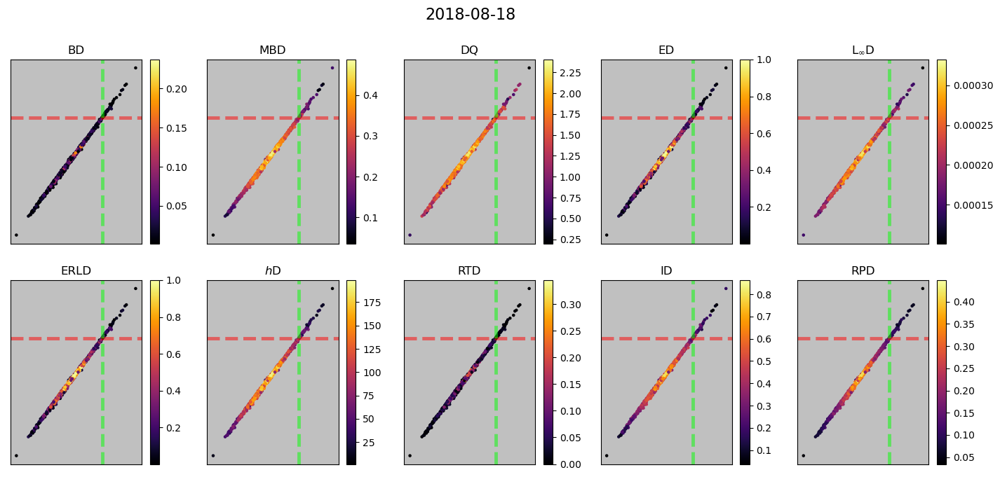

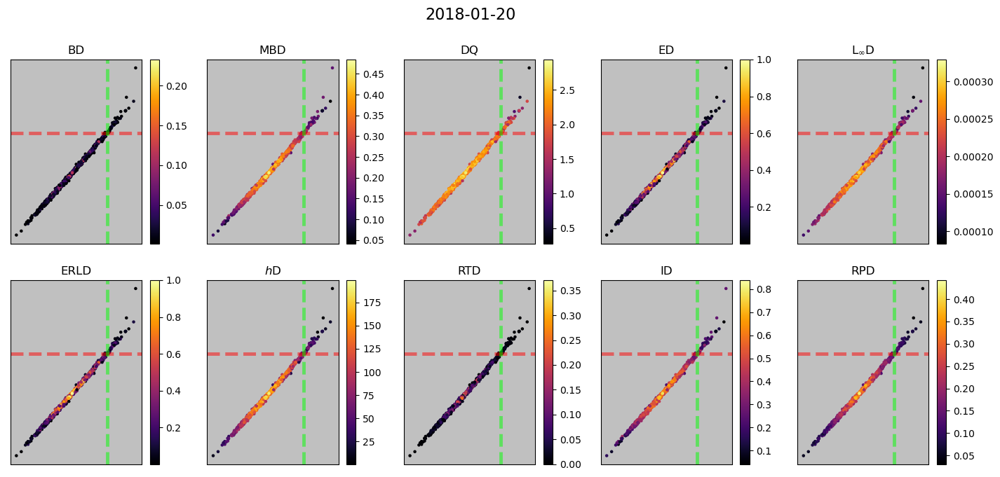

In [16]:
i_feature = 4
i_vatic   = 0

for i_day in range(N_days):

    y_ = Y_[:, i_vatic, i_day]
    x_ = np.sum(X_[i_feature][..., i_day], axis = 1)
    #x_ = np.max(X_[i_feature][..., i_day], axis = 1) + np.min(X_[i_feature][..., i_day], axis = 1) + np.mean(X_[i_feature][..., i_day], axis = 1)
    #x_ = np.sum(np.diff(X_[i_feature][..., i_day], axis = 1), axis = 1)

    idx_extreme_ = np.argsort(y_)
    idx_area_    = np.argsort(x_)

    y = y_[idx_extreme_][-50]
    x = x_[idx_area_][-50]
        
    plt.figure(figsize = (17.5, 7.5))
    plt.suptitle(dates_[i_day], fontsize = 16)
    
    for i_metric in range(N_metrics):

        ax = plt.subplot2grid( (2, 5), idx_plot_[i_metric] )
#
        z_ = aggFunAUC_[i_metric, i_feature, i_day, :]
        #z_ = fdiff_[i_metric, i_feature, i_day, :]

        #z_ = 1. - z_/z_.sum()
            
        ax.set_title(metrics_[i_metric], fontsize = 12)
        ax.axhline(x, color     = 'red', 
                       linestyle = '--', 
                       linewidth = 3.5, 
                       alpha     = 0.5)

        
        ax.axvline(y, color     = 'lime', 
                       linestyle = '--', 
                       linewidth = 3.5, 
                       alpha     = 0.5)
        
        ax.set_xticks([],[])
        ax.set_yticks([],[])

        im = ax.scatter(y_, x_, c = z_, s = 5., cmap = 'inferno')
        
        # add the bar
        cbar = plt.colorbar(im)
        
    plt.show()

In [24]:
i_feature = 4
i_vatic   = 0

N_extreme = 50
N_sel     = 50
N_area    = 60

score_fdepth_ = np.zeros((N_days, N_metrics))
score_bl_     = np.zeros((N_days,))
score_sample_ = np.zeros((N_days,))

for i_day in range(N_days):

    y_ = Y_[:, i_vatic, i_day]
    x_ = np.sum(X_[i_feature][..., i_day], axis = 1)
    #x_ = np.sum(np.diff(X_[i_feature][..., i_day], axis = 1), axis = 1)

    idx_extreme_ = np.argsort(y_)[::-1]
    idx_area_    = np.argsort(x_)[::-1]
    
    score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extreme], idx_area_[:N_sel]).shape[0]
        
    ranks_ = []
    for i_metric in range(N_metrics):

        idx_depth_ = np.argsort(aggFunAUC_[i_metric, i_feature, i_day, idx_area_[:N_area]])
        #idx_depth_ = np.argsort(fdiff_[i_metric, i_feature, i_day, idx_area_[:N_area]])

        ranks_.append(idx_area_[:N_area][idx_depth_[:N_sel]])
        
        score_fdepth_[i_day, i_metric] = np.intersect1d(idx_extreme_[:N_extreme], ranks_[-1]).shape[0]
        
    ranks_ = np.stack(ranks_)
    for i in range(N_area):
        idx_ensamble_ = np.unique(ranks_[:, :i])
        if idx_ensamble_.shape[0] == N_sel:
            break
        if idx_ensamble_.shape[0] > N_sel:
            idx_ensamble_ = idx_ensamble_[:N_sel]
            break
    
    score_sample_[i_day] = np.intersect1d(idx_extreme_[:N_extreme], idx_ensamble_).shape[0]

name = 'e{}v{}f{}auc{}s{}.png'.format(N_extreme, i_vatic, i_feature, N_sel, N_area)
print(name)

caption_ = "Top {} {} | -Feature: {} -# AUC Filtered: {} -# Selected: {}".format(N_extreme, vatic_[i_vatic], features_[i_feature], N_area, N_sel)
df_ = np.concatenate([score_bl_[:, np.newaxis], score_fdepth_, score_sample_[:, np.newaxis]], axis = 1)
df_ = np.concatenate([df_, np.mean(df_, axis = 0)[np.newaxis, :], np.median(df_, axis = 0)[np.newaxis, :]], axis = 0)   
df_ = pd.DataFrame(df_, columns = ['AUC'] +  metrics_ + ['Ensamble'] , index = dates_.tolist() + ['Mean', 'Meadian'])
print(caption_)
#display(df_)
#print(df_.to_latex())

e50v0f4auc50s60.png


ValueError: Shape of passed values is (27, 12), indices imply (27, 13)

## Aggregated Extreme Reserve Shortfall Detection

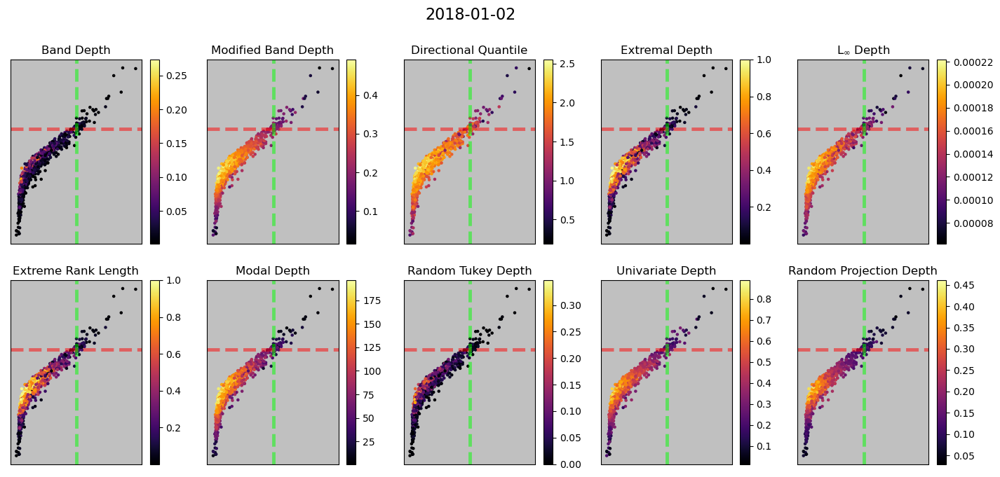

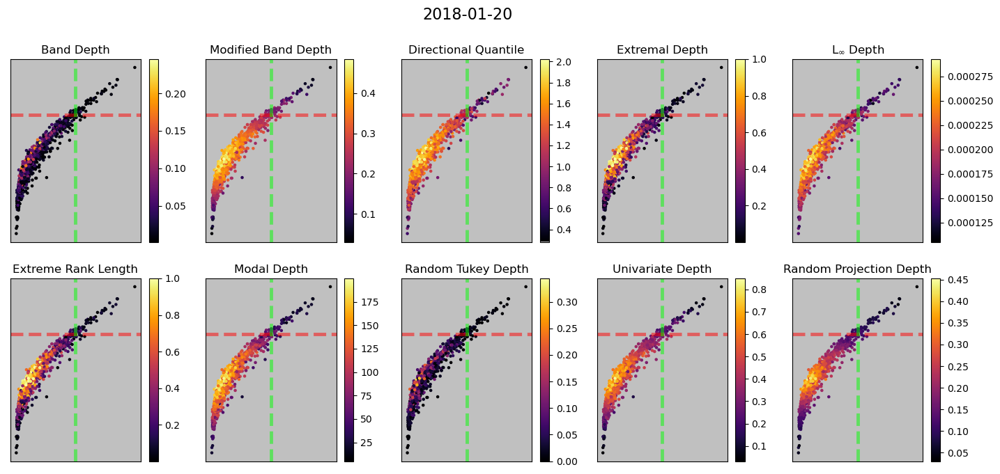

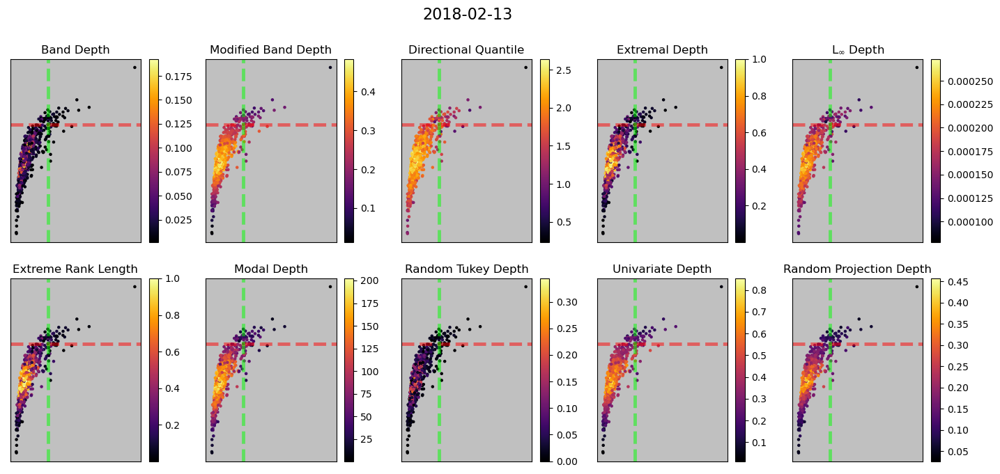

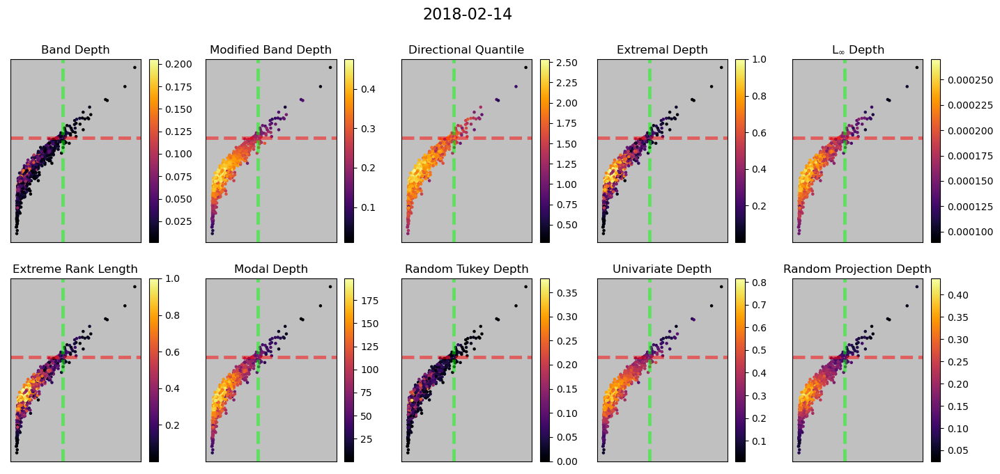

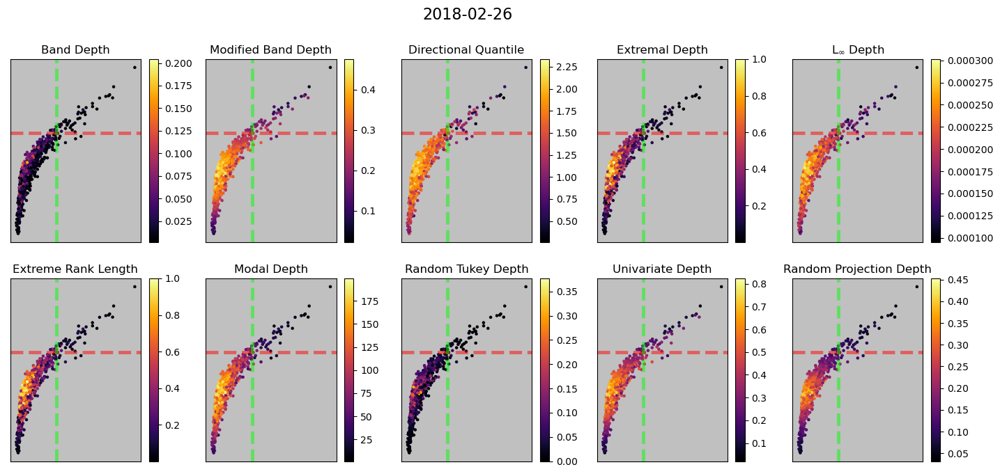

...

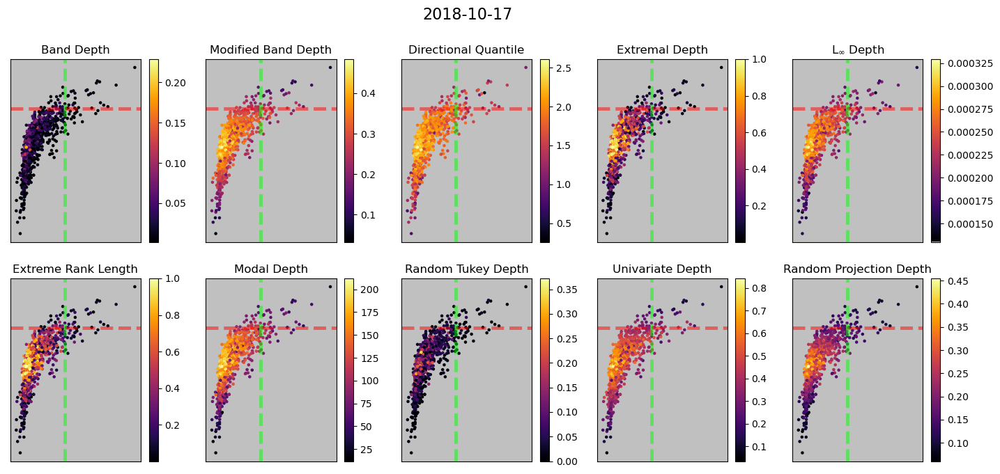

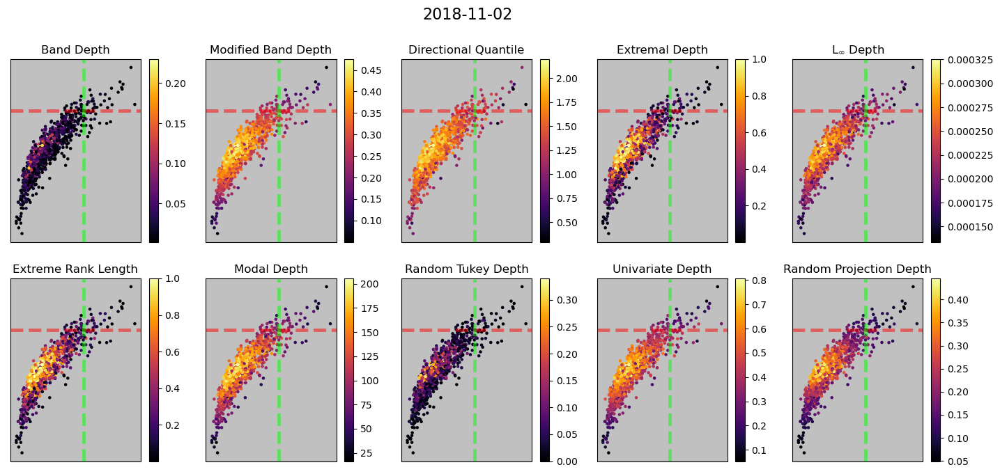

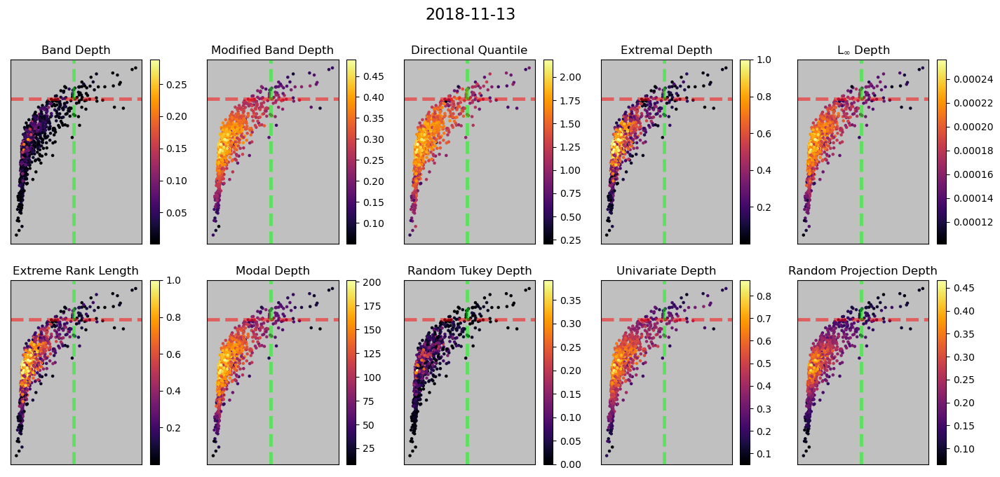

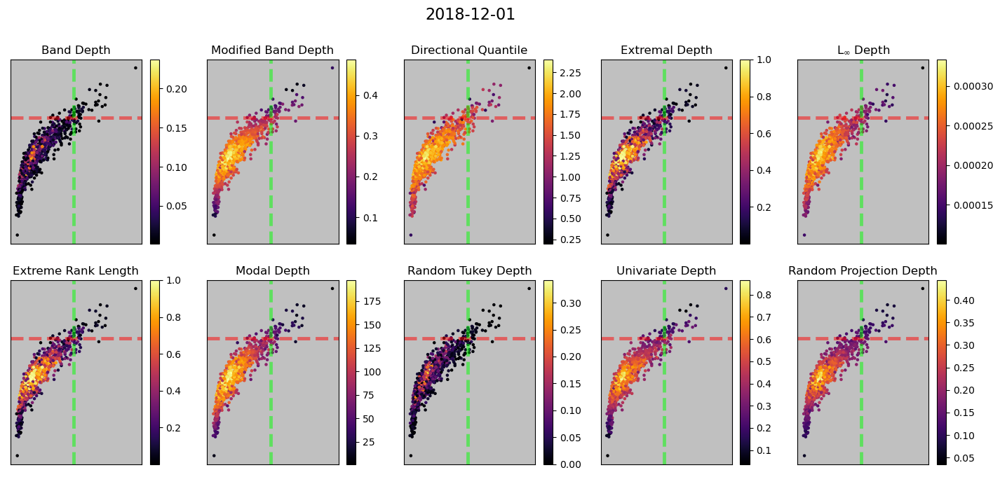

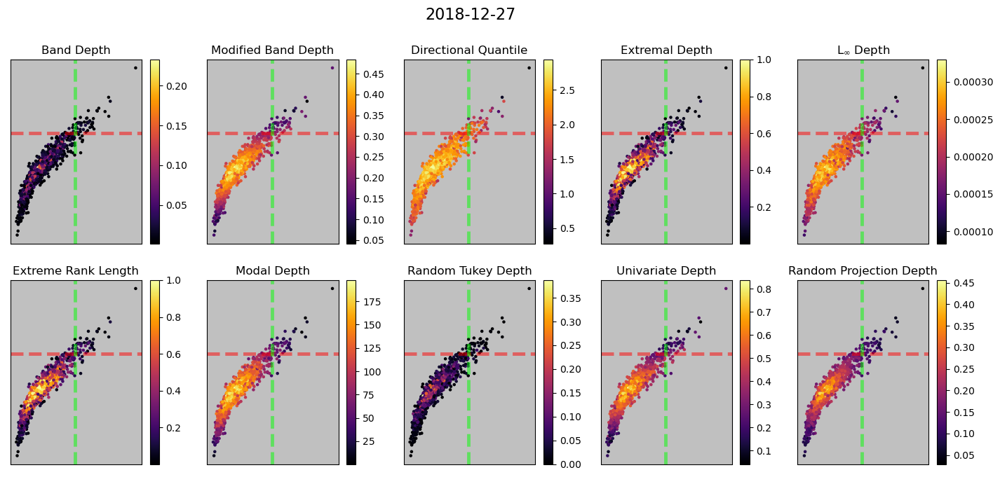

In [493]:
i_feature = 4
i_vatic   = 3

for i_day in range(N_days):


    y_ = Y_[:, i_vatic, i_day]
    x_ = np.sum(X_[i_feature][..., i_day], axis = 1)
    #x_ = np.max(X_[i_feature][..., i_day], axis = 1) + np.min(X_[i_feature][..., i_day], axis = 1) + np.mean(X_[i_feature][..., i_day], axis = 1)

    idx_extreme_ = np.argsort(y_)
    idx_area_    = np.argsort(x_)

    y = y_[idx_extreme_][-50]
    x = x_[idx_area_][-50]
        
    plt.figure(figsize = (17.5, 7.5))
    plt.suptitle(dates_[i_day], fontsize = 16)

    for i_metric in range(N_metrics):

        ax = plt.subplot2grid( (2, 5), idx_plot_[i_metric] )
#
        z_ = aggFunAUC_[i_metric, i_feature, i_day, :]
        #z_ = 1. - z_/z_.sum()
            
        ax.set_title(metrics_[i_metric], fontsize = 12)
        ax.axhline(x, color     = 'red', 
                       linestyle = '--', 
                       linewidth = 3.5, 
                       alpha     = 0.5)

        ax.axvline(y, color     = 'lime', 
                       linestyle = '--', 
                       linewidth = 3.5, 
                       alpha     = 0.5)
        
        ax.set_xticks([],[])
        ax.set_yticks([],[])

        im = ax.scatter(y_, x_, c = z_, s = 5., cmap = 'inferno')
        
        # add the bar
        cbar = plt.colorbar(im)

    plt.show()

In [494]:
i_feature = 4
i_vatic   = 3

N_extreme = 50
N_sel     = 200
N_area    = 300
#
score_fdepth_ = np.zeros((N_days, N_metrics))
score_bl_     = np.zeros((N_days,))
score_sample_ = np.zeros((N_days,))

for i_day in range(N_days):

    y_ = Y_[:, i_vatic, i_day]
    x_ = np.sum(X_[i_feature][..., i_day], axis = 1)
    
    idx_extreme_ = np.argsort(y_)[::-1]
    idx_area_    = np.argsort(x_)[::-1]
    
    score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extreme], idx_area_[:N_sel]).shape[0]
        
    ranks_ = []
    for i_metric in range(N_metrics):

        idx_depth_ = np.argsort(aggFunAUC_[i_metric, i_feature, i_day, idx_area_[:N_area]])
        #idx_depth_ = np.argsort(fdiff_[i_metric, i_feature, i_day, idx_area_[:N_area]])

        ranks_.append(idx_area_[:N_area][idx_depth_[:N_sel]])
        
        score_fdepth_[i_day, i_metric] = np.intersect1d(idx_extreme_[:N_extreme], ranks_[-1]).shape[0]
        
    ranks_ = np.stack(ranks_)
    for i in range(N_area):
        idx_ensamble_ = np.unique(ranks_[:, :i])
        if idx_ensamble_.shape[0] == N_sel:
            break
        if idx_ensamble_.shape[0] > N_sel:
            idx_ensamble_ = idx_ensamble_[:N_sel]
            break
    score_sample_[i_day] = np.intersect1d(idx_extreme_[:N_extreme], idx_ensamble_).shape[0]

name = 'e{}v{}f{}auc{}s{}.png'.format(N_extreme, i_vatic, i_feature, N_sel, N_area)
print(name)

caption_ = "Top {} {} | -Feature: {} -# AUC Filtered: {} -# Selected: {}".format(N_extreme, vatic_[i_vatic], features_[i_feature], N_area, N_sel)
df_ = np.concatenate([score_bl_[:, np.newaxis], score_fdepth_, score_sample_[:, np.newaxis]], axis = 1)
df_ = np.concatenate([df_, np.mean(df_, axis = 0)[np.newaxis, :], np.median(df_, axis = 0)[np.newaxis, :]], axis = 0)   
df_ = pd.DataFrame(df_, columns = ['AUC'] +  metrics_ + ['Ensamble'] , index = dates_.tolist() + ['Mean', 'Meadian'])
print(caption_)
display(df_)

e50v3f4auc200s300.png
Top 50 Reserve Shortfall | -Feature: Net Load -# AUC Filtered: 300 -# Selected: 200


,AUC,Band Depth,Modified Band Depth,Directional Quantile,Extremal Depth,L$_\infty$ Depth,Extreme Rank Length,Modal Depth,Random Tukey Depth,Univariate Depth,Random Projection Depth,Ensamble
2018-01-02,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.0,50.00,50.00,50.00,50.00
2018-01-20,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.0,50.00,50.00,50.00,50.00
2018-02-13,48.00,48.00,48.00,48.00,48.00,48.00,48.00,48.0,48.00,46.00,48.00,48.00
2018-02-14,50.00,49.00,50.00,50.00,50.00,50.00,50.00,50.0,50.00,50.00,50.00,50.00
2018-02-26,50.00,48.00,50.00,50.00,50.00,50.00,50.00,50.0,50.00,50.00,50.00,50.00
2018-03-14,50.00,48.00,50.00,50.00,50.00,50.00,50.00,50.0,50.00,50.00,50.00,49.00
2018-04-01,50.00,48.00,50.00,50.00,50.00,50.00,50.00,50.0,50.00,50.00,50.00,50.00
2018-04-09,47.00,47.00,48.00,50.00,50.00,50.00,50.00,50.0,46.00,48.00,48.00,50.00
2018-04-24,49.00,49.00,49.00,49.00,49.00,49.00,49.00,49.0,49.00,49.00,49.00,49.00
2018-05-10,46.00,49.00,50.00,50.00,49.00,50.00,49.00,50.0,49.00,49.00,50.00,49.00


## Aggregated Extreme Load Shadding Detection

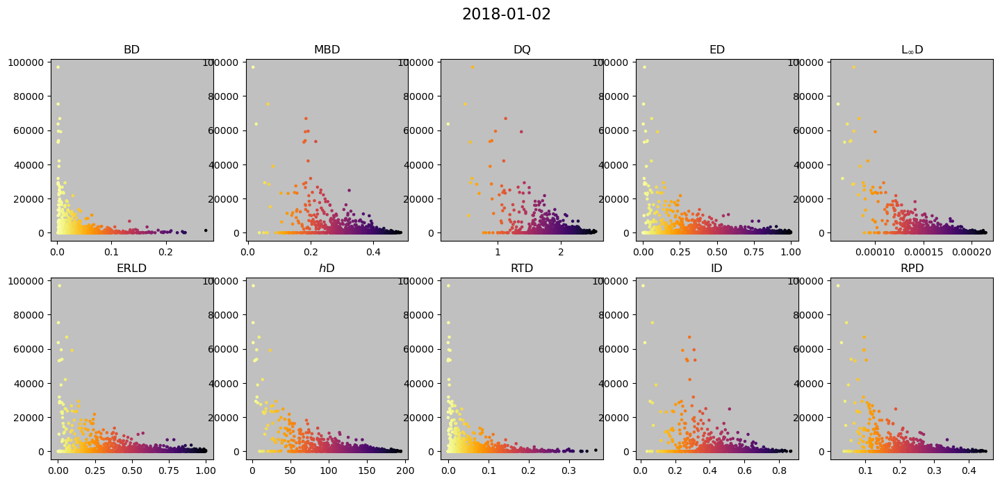

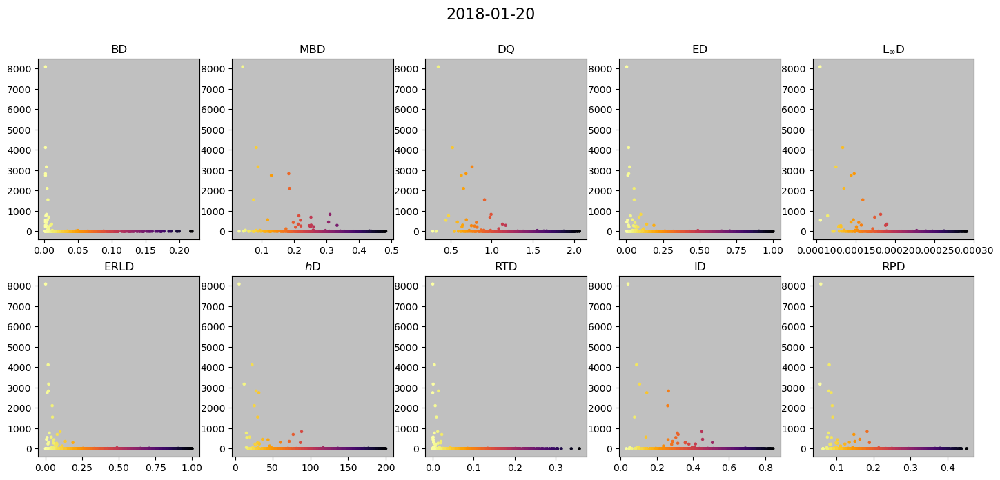

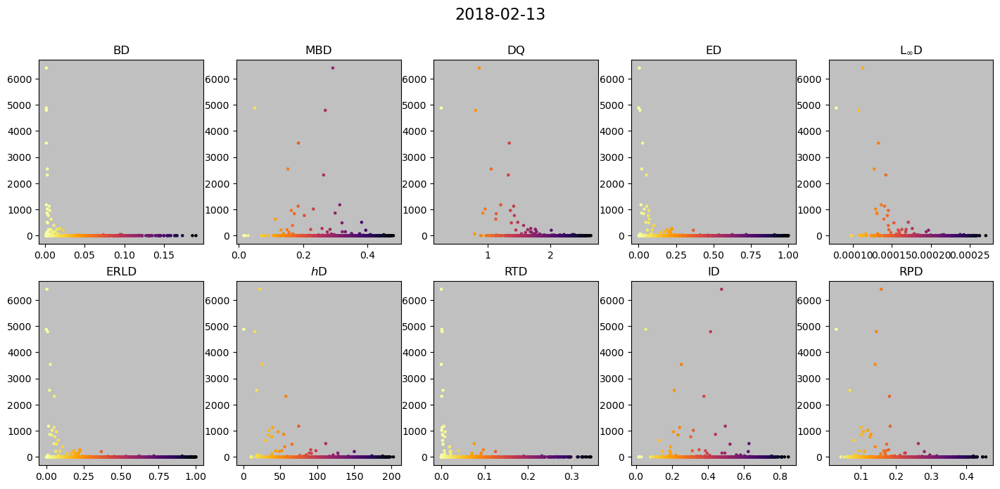

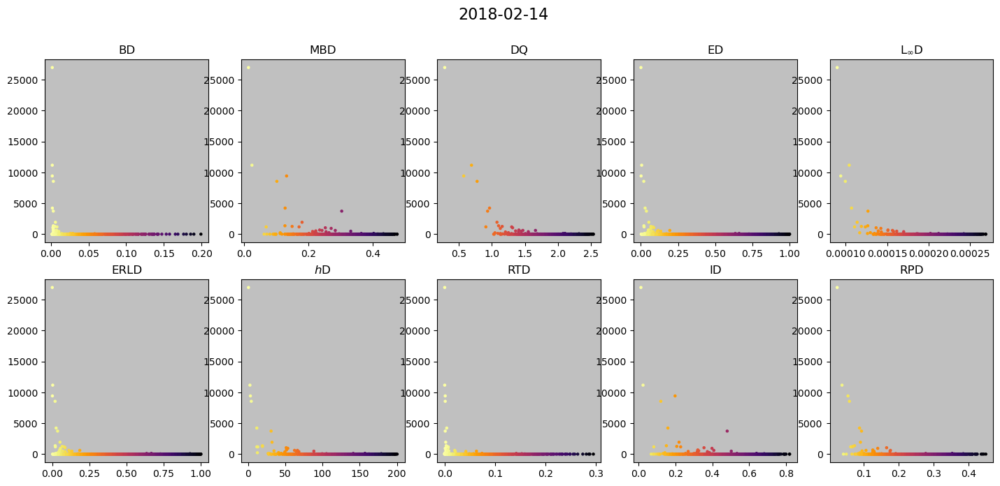

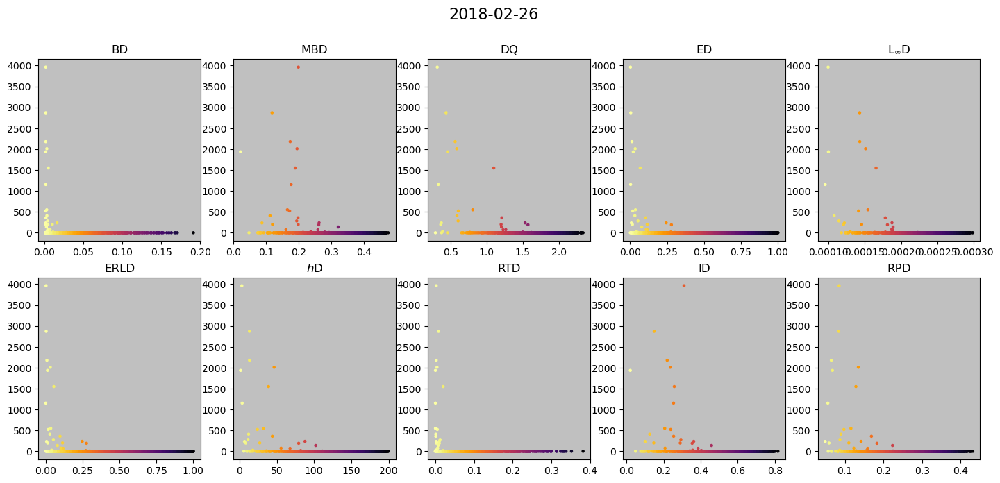

...

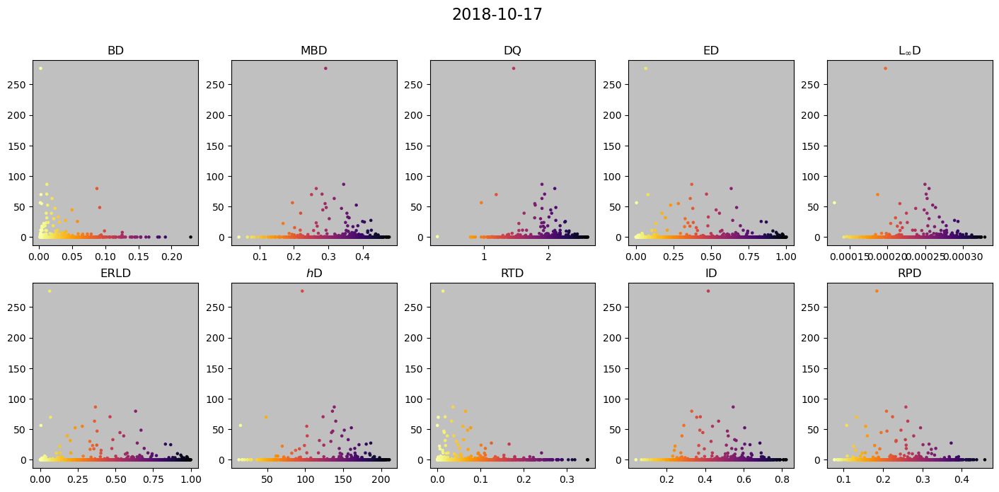

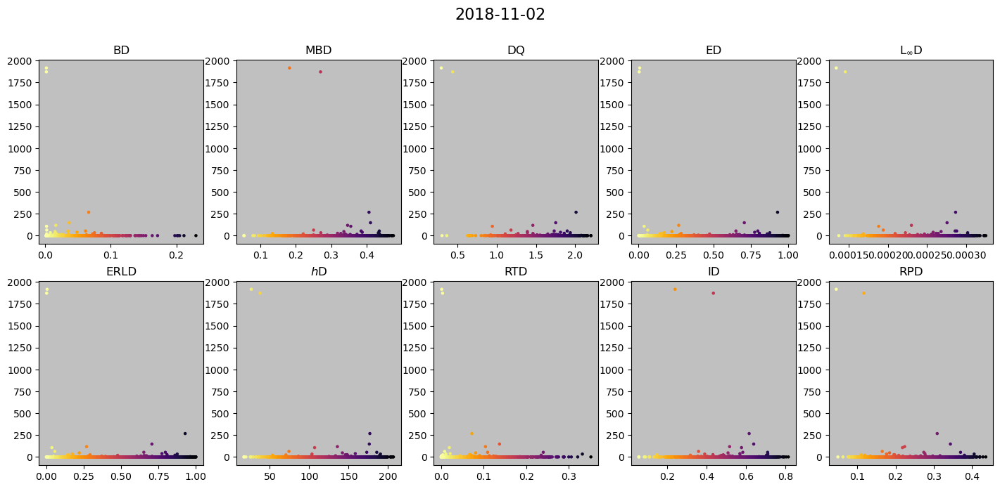

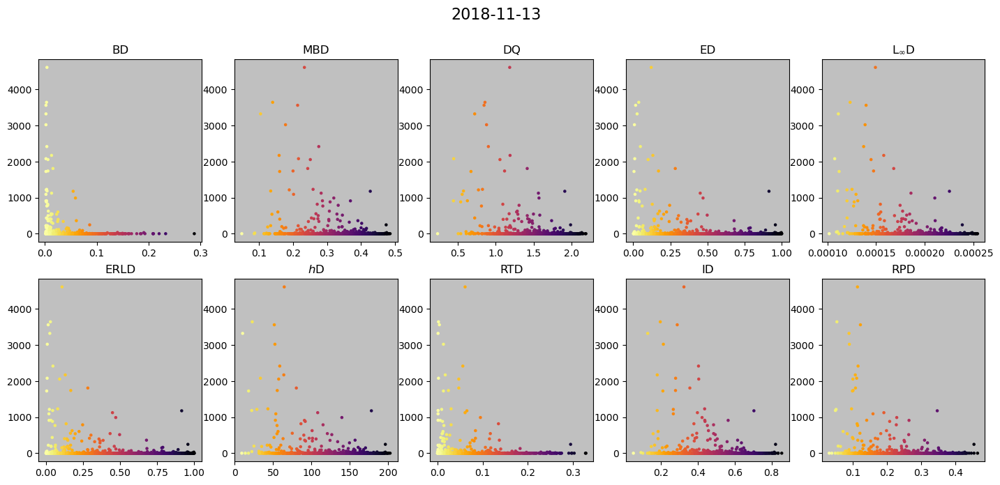

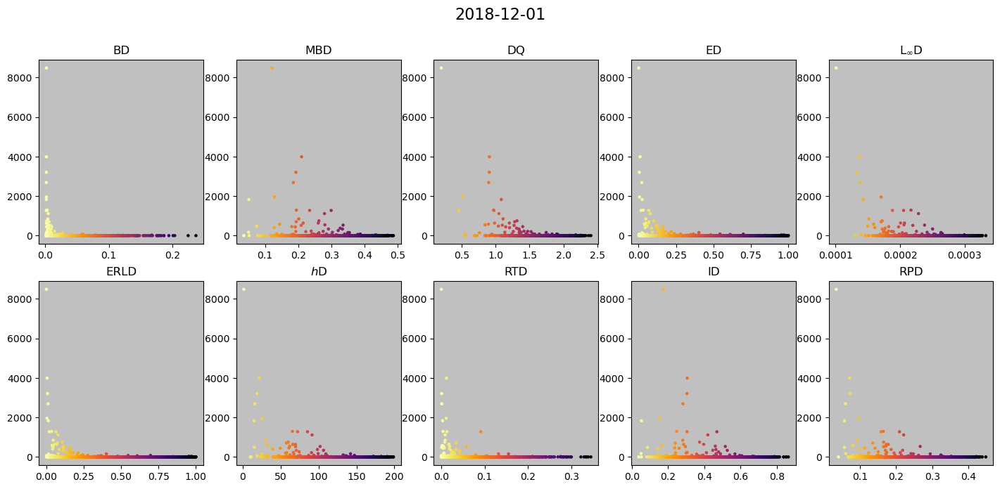

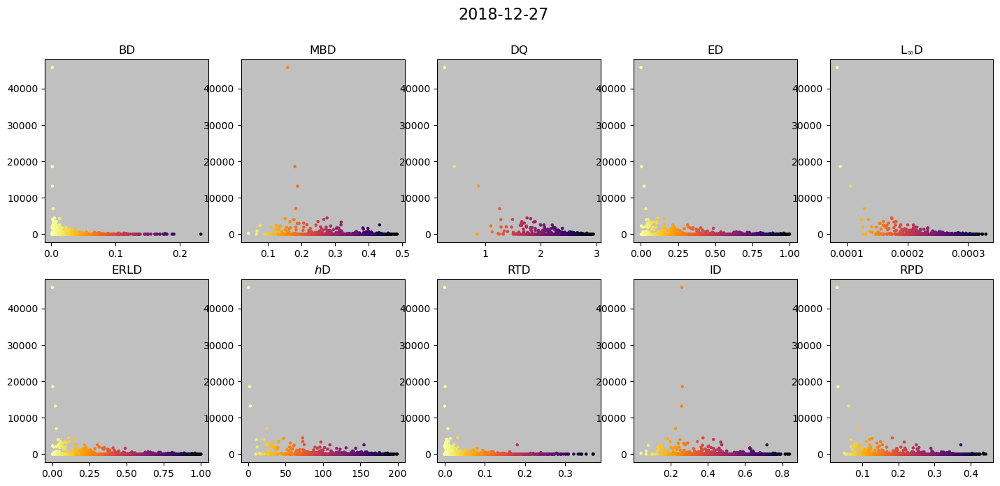

In [132]:
i_feature = 4
i_vatic   = 1

for i_day in range(N_days):

    y_ = Y_[:, i_vatic, i_day]
    x_ = np.mean(X_[i_feature][..., i_day], axis = 1)
    #x_ = np.max(X_[i_feature][..., i_day], axis = 1) + np.min(X_[i_feature][..., i_day], axis = 1) + np.mean(X_[i_feature][..., i_day], axis = 1)

    idx_extreme_ = np.argsort(y_)
    idx_area_    = np.argsort(x_)

    y = y_[idx_extreme_][-50]
    x = x_[idx_area_][-50]
        
    plt.figure(figsize = (17.5, 7.5))
    plt.suptitle(dates_[i_day], fontsize = 16)

    for i_metric in range(N_metrics):

        ax = plt.subplot2grid( (2, 5), idx_plot_[i_metric] )
#
        z_ = aggFunAUC_[i_metric, i_feature, i_day, :]
        #z_ = fdiff_[i_metric, i_feature, i_day, :]

        #z_ = 1. - z_/z_.sum()
            
        ax.set_title(metrics_[i_metric], fontsize = 12)
#         ax.axhline(x, color     = 'red', 
#                        linestyle = '--', 
#                        linewidth = 3.5, 
#                        alpha     = 0.5)

        
        # ax.axvline(y, color     = 'lime', 
        #                linestyle = '--', 
        #                linewidth = 3.5, 
        #                alpha     = 0.5)
        
        # ax.set_xticks([],[])
        # ax.set_yticks([],[])

        im = ax.scatter(z_, y_, c = 1. - z_/z_.sum(), s = 5., cmap = 'inferno')
        
        # # add the bar
        # cbar = plt.colorbar(im)

    plt.show()

In [281]:
i_feature = 4
i_vatic   = 1

N_extreme = 50
N_min_sel = 200
N_area    = 650

score_fdepth_ = np.zeros((N_days, N_metrics))
score_bl_     = np.zeros((N_days,))
score_sample_ = np.zeros((N_days,))
N_extremes_   = np.zeros((N_days,), dtype = int)
N_sel_   = np.zeros((N_days,), dtype = int)

total_        = np.zeros((N_days,) )

for i_day in range(N_days):

    y_ = Y_[:, i_vatic, i_day]
    x_ = np.sum(X_[i_feature][..., i_day], axis = 1)
    
    N_extremes_[i_day] = int(np.sum(y_ > 0.))
    # if N_extremes_[i_day] > N_sel:
    #     N_extremes_[i_day] = N_sel
        
    idx_sel_1_ = np.sum(X_[i_feature][..., i_day] > 68000., axis = 1) > 0.
    N_sel_[i_day] = N_min_sel + idx_sel_1_.sum()
    N_sel = N_sel_[i_day]

    idx_extreme_ = np.argsort(y_)[::-1]
    idx_area_    = np.argsort(x_)[::-1]
    
    total_[i_day] = y_[idx_extreme_[:N_extremes_[i_day]]].sum()/1000.
    #total_[i_day] = N_sel

    #print(dates_[i_day], N_extremes_[i_day], N_sel)

    #score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extreme], idx_area_[:N_sel]).shape[0]
    #score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_area_[:N_sel]).shape[0]/N_extremes_[i_day]

    idx_ = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_area_[:N_sel])
    #score_bl_[i_day] = y_[idx_].sum()/y_[idx_extreme_[:N_extremes_[i_day]]].sum()
    score_bl_[i_day] = y_[idx_].sum()/1000.

    ranks_ = []
    for i_metric in range(N_metrics):
        

        idx_depth_ = np.argsort(aggFunAUC_[i_metric, i_feature, i_day, idx_area_[:N_area]])
        #idx_depth_ = np.argsort(aggFunDiff_[i_metric, i_feature, i_day, idx_area_[:N_area]])

        ranks_.append(idx_area_[:N_area][idx_depth_[:N_sel]])
        
        #print(i_day, i_metric, y_[idx_].sum()/y_[idx_extreme_[:N_extremes_[i_day]]].sum(), y_[idx_].shape[0]/N_extremes_[i_day])
    
        #score_fdepth_[i_day, i_metric] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], ranks_[-1]).shape[0]/N_extremes_[i_day]
        idx_ = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], ranks_[-1])
        #score_fdepth_[i_day, i_metric] = y_[idx_].sum()/y_[idx_extreme_[:N_extremes_[i_day]]].sum()
        score_fdepth_[i_day, i_metric] = y_[idx_].sum()/1000.

    ranks_ = np.stack(ranks_)
    for i in range(N_area):
        idx_ensamble_ = np.unique(ranks_[:, :i])
        if idx_ensamble_.shape[0] == N_sel:
            break
        if idx_ensamble_.shape[0] > N_sel:
            idx_ensamble_ = idx_ensamble_[:N_sel]
            break

    #print(i_day, y_[idx_].sum()/y_[idx_extreme_[:N_extremes_[i_day]]].sum(), y_[idx_].shape[0]/N_extremes_[i_day])

    #score_sample_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_ensamble_).shape[0]/N_extremes_[i_day]
    idx_ = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_ensamble_)
    #score_sample_[i_day] = y_[idx_].sum()/y_[idx_extreme_[:N_extremes_[i_day]]].sum()
    score_sample_[i_day] = y_[idx_].sum()/1000.
 
name = 'e{}v{}f{}auc{}s{}.png'.format(N_extreme, i_vatic, i_feature, N_sel, N_area)
print(name)

caption_ = "{} Events | -Feature: {} -# AUC Filtered: {} -# Selected: {}".format(vatic_[i_vatic], features_[i_feature], N_area, N_sel)

df_ = np.concatenate([N_extremes_[:, np.newaxis], total_[:, np.newaxis], score_bl_[:, np.newaxis], score_fdepth_, score_sample_[:, np.newaxis]], axis = 1)
df_ = np.nan_to_num(df_, nan = 1.)
df_ = np.concatenate([df_, np.mean(df_, axis = 0)[np.newaxis, :], np.median(df_, axis = 0)[np.newaxis, :]], axis = 0)   
df_ = pd.DataFrame(df_, columns = ['No. Scen.', 'Energy [MWh]'] + ['AUC'] +  metrics_ + ['Ensamble'] , index = dates_.tolist() + ['Mean', 'Median'])
print(caption_)
display(df_)

e50v1f4auc200s650.png
Load Shedding Events | -Feature: Net Load -# AUC Filtered: 650 -# Selected: 200


,No. Scen.,Energy [MWh],AUC,BD,MBD,DQ,ED,L$_\infty$D,ERLD,$h$D,RTD,ID,RPD,Ensamble
2018-01-02,681.00,2573.914805,2242.374125,1997.446510,2231.703859,2188.596495,2216.044345,2255.798965,2216.044345,2269.245174,2076.754620,2203.257006,2258.184189,2202.923760
2018-01-20,41.00,31.501738,30.986725,31.383107,31.139530,31.392361,31.392361,31.395243,31.392361,31.388166,31.399222,29.856646,31.426778,31.388166
2018-02-13,55.00,35.924320,31.041321,35.196354,34.096907,35.490054,35.490054,35.358652,35.490054,35.266428,34.298874,26.514878,34.669691,35.516079
2018-02-14,50.00,78.579838,78.085032,78.093385,77.681498,78.164755,78.164755,78.164755,78.164755,78.150765,77.097343,73.978725,78.181963,78.151068
2018-02-26,24.00,19.174885,18.488959,18.932483,19.036880,19.174885,19.174885,19.169364,19.174885,19.174885,19.169364,19.174885,19.031359,19.169364
2018-03-14,75.00,72.868317,61.909063,69.602909,63.511273,71.776566,71.776566,68.753117,71.776566,67.508376,66.643755,59.399330,66.991150,70.445580
2018-04-01,131.00,108.298208,70.874245,73.325820,72.897806,79.680986,80.155982,73.907586,79.680986,79.451293,67.525266,74.400252,72.691379,74.155080
2018-04-09,61.00,39.314138,32.805171,34.167332,30.785238,35.765138,34.969889,37.224979,34.969889,35.354462,26.952535,29.548642,32.670858,34.044505
2018-04-24,159.00,127.520742,98.603009,101.147032,97.407969,111.008612,111.655920,114.531480,111.655920,110.263344,104.798501,89.337427,103.599514,106.083177
2018-05-10,99.00,54.397510,40.048418,41.512678,40.399666,47.092999,46.625630,40.341703,46.625630,39.868207,34.616450,40.233525,40.753443,42.538297


In [208]:
i_feature = 4
i_vatic   = 1

N_extreme = 50
N_sel     = 200
N_area    = 500

score_fdepth_ = np.zeros((N_days, N_metrics))
score_bl_     = np.zeros((N_days,))
score_sample_ = np.zeros((N_days,))
N_extremes_   = np.zeros((N_days,), dtype = int)
N_sel_   = np.zeros((N_days,), dtype = int)

total_        = np.zeros((N_days,) )

for i_day in range(N_days):

    y_ = Y_[:, i_vatic, i_day]
    x_ = np.sum(X_[i_feature][..., i_day], axis = 1)
    
    N_extremes_[i_day] = int(np.sum(y_ > 0.))
    # if N_extremes_[i_day] > N_sel:
    #     N_extremes_[i_day] = N_sel
        
    idx_sel_1_ = np.sum(X_[i_feature][..., i_day] > 66000., axis = 1) > 0.
    
    idx_sel_2_ = np.max(X_[i_feature][..., i_day], axis = 1) - np.min(X_[i_feature][..., i_day], axis = 1) < 15000.
    idx_sel_3_ = np.sum(np.std(X_[i_feature][..., i_day], axis = 0)) > 40000.
    #print(np.median(np.diff(X_[i_feature][..., i_day], axis = 1), axis = 1).shape)
    idx_sel_4_ = np.mean(np.diff(X_[i_feature][..., i_day], axis = 1), axis = 1) > 400.

    N_sel_[i_day] = idx_sel_1_.sum() + N_sel
    print(dates_[i_day], N_extremes_[i_day], N_sel_[i_day])
    
print(np.mean(N_sel_/N_extremes_))
print(np.median(N_sel_/N_extremes_))

2018-01-02 681 343
2018-01-20 41 200
2018-02-13 55 200
2018-02-14 50 200
2018-02-26 24 200
2018-03-14 75 200
2018-04-01 131 200
2018-04-09 61 200
2018-04-24 159 200
2018-05-10 99 200
2018-05-25 166 200
2018-06-04 72 200
2018-06-30 89 200
2018-07-22 855 962
2018-07-24 198 542
2018-08-08 213 279
2018-08-18 42 201
2018-09-04 7 200
2018-09-14 49 200
2018-10-02 118 200
2018-10-17 96 200
2018-11-02 34 200
2018-11-13 179 200
2018-12-01 69 200
2018-12-27 174 200
3.830735674800957
2.6666666666666665


In [213]:
i_feature = 4
i_vatic   = 1

N_extreme = 50
N_sel     = 200
N_area    = 700

score_fdepth_ = np.zeros((N_days, N_metrics))
score_bl_     = np.zeros((N_days,))
score_sample_ = np.zeros((N_days,))
N_extremes_   = np.zeros((N_days,), dtype = int)
N_sel_   = np.zeros((N_days,), dtype = int)

for i_day in range(N_days):

    y_ = Y_[:, i_vatic, i_day]
    x_ = np.sum(X_[i_feature][..., i_day], axis = 1)
    
    N_extremes_[i_day] = int(np.sum(y_ > 0.))
    # if N_extremes_[i_day] > N_sel:
    #     N_extremes_[i_day] = N_sel
        
    idx_extreme_ = np.argsort(y_)[::-1]
    idx_area_    = np.argsort(x_)[::-1]
    
    idx_sel_1_ = np.sum(X_[i_feature][..., i_day] > 66000., axis = 1) > 0.
    N_sel_[i_day] = N_sel
    N_sel = N_sel_[i_day]
    
    #score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extreme], idx_area_[:N_sel]).shape[0]
    score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_area_[:N_sel]).shape[0]/N_extremes_[i_day]


    for i_metric in range(N_metrics):
        ranks_ = []

        for i_features in [4]:
            if (i_features == 1) or (i_features == 2) or (i_features == 3):
                idx_depth_ = np.argsort(aggFunAUC_[i_metric, i_feature, i_day, idx_area_[:N_area]])
                #idx_depth_ = np.argsort(aggFunDiff_[i_metric, i_features, i_day, idx_area_[:N_area]])
            else:
                idx_depth_ = np.argsort(aggFunAUC_[i_metric, i_feature, i_day, idx_area_[:N_area]])
                #idx_depth_ = np.argsort(aggFunDiff_[i_metric, i_features, i_day, idx_area_[:N_area]])
            ranks_.append(idx_area_[:N_area][idx_depth_[:N_sel]])
            
        ranks_ = np.stack(ranks_)

        for i in range(N_area):
            idx_ensamble_ = np.unique(ranks_[:, :i])
            if idx_ensamble_.shape[0] == N_sel:
                break
            if idx_ensamble_.shape[0] > N_sel:
                idx_ensamble_ = idx_ensamble_[:N_sel]
                break
            
        #score_sample_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_ensamble_).shape[0]/N_extremes_[i_day]
        score_fdepth_[i_day, i_metric] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_ensamble_).shape[0]/N_extremes_[i_day]


name = 'e{}v{}f{}auc{}s{}.png'.format(N_extreme, i_vatic, i_feature, N_sel, N_area)
print(name)

caption_ = "{} Events | -Feature: {} -# AUC Filtered: {} -# Selected: {}".format(vatic_[i_vatic], features_[i_feature], N_area, N_sel)

df_ = np.concatenate([N_extremes_[:, np.newaxis], score_bl_[:, np.newaxis], score_fdepth_], axis = 1)
df_ = np.concatenate([df_, np.mean(df_, axis = 0)[np.newaxis, :], np.median(df_, axis = 0)[np.newaxis, :]], axis = 0)   
df_ = pd.DataFrame(df_, columns = ['No. Scen.'] + ['AUC'] +  metrics_, index = dates_.tolist() + ['Mean', 'Median'])
print(caption_)
display(df_)

e50v1f4auc200s700.png
Load Shedding Events | -Feature: Net Load -# AUC Filtered: 700 -# Selected: 200


,No. Scen.,AUC,BD,MBD,DQ,ED,L$_\infty$D,ERLD,$h$D,RTD,ID,RPD
2018-01-02,681.00,0.293686,0.276065,0.286344,0.283407,0.283407,0.289280,0.283407,0.289280,0.280470,0.286344,0.293686
2018-01-20,41.00,0.780488,0.780488,0.780488,0.804878,0.804878,0.829268,0.804878,0.780488,0.780488,0.707317,0.804878
2018-02-13,55.00,0.618182,0.727273,0.654545,0.781818,0.781818,0.763636,0.781818,0.727273,0.654545,0.618182,0.709091
2018-02-14,50.00,0.800000,0.700000,0.760000,0.780000,0.780000,0.780000,0.780000,0.780000,0.700000,0.760000,0.840000
2018-02-26,24.00,0.875000,0.916667,0.958333,1.000000,1.000000,0.958333,1.000000,1.000000,0.958333,0.958333,0.916667
2018-03-14,75.00,0.800000,0.760000,0.706667,0.946667,0.946667,0.800000,0.960000,0.813333,0.706667,0.680000,0.840000
2018-04-01,131.00,0.564885,0.450382,0.557252,0.549618,0.549618,0.519084,0.549618,0.580153,0.473282,0.572519,0.541985
2018-04-09,61.00,0.639344,0.655738,0.590164,0.704918,0.721311,0.803279,0.721311,0.688525,0.540984,0.606557,0.622951
2018-04-24,159.00,0.578616,0.534591,0.547170,0.597484,0.603774,0.647799,0.597484,0.616352,0.597484,0.522013,0.566038
2018-05-10,99.00,0.626263,0.606061,0.696970,0.747475,0.737374,0.616162,0.737374,0.676768,0.595960,0.696970,0.676768


## Aggregated Energy Curtailment Detection

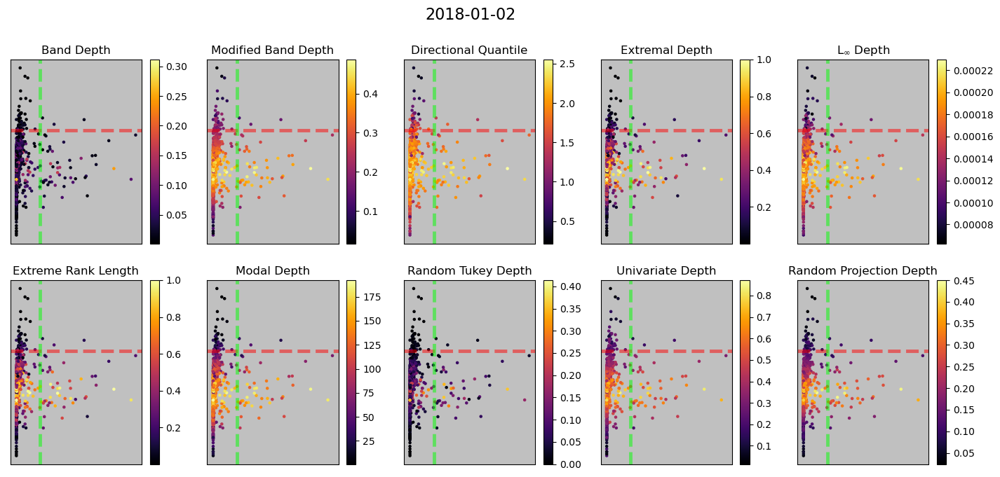

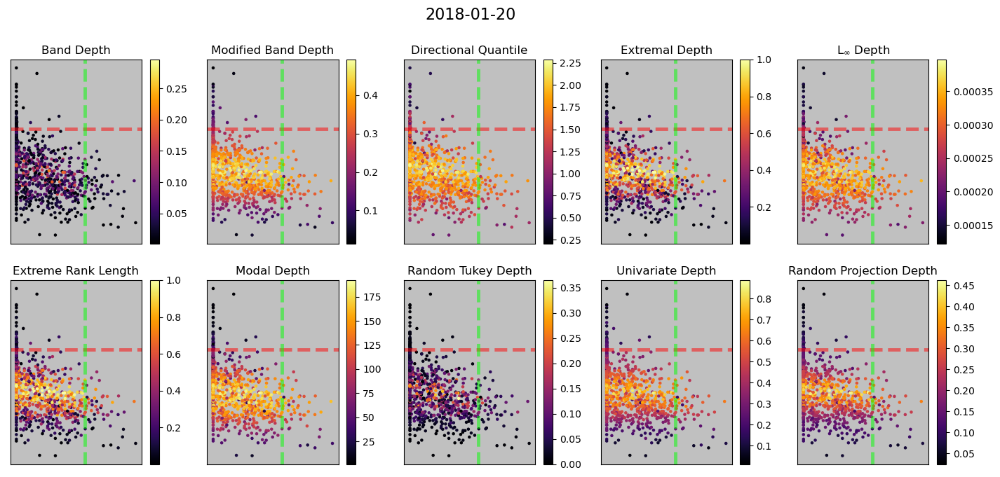

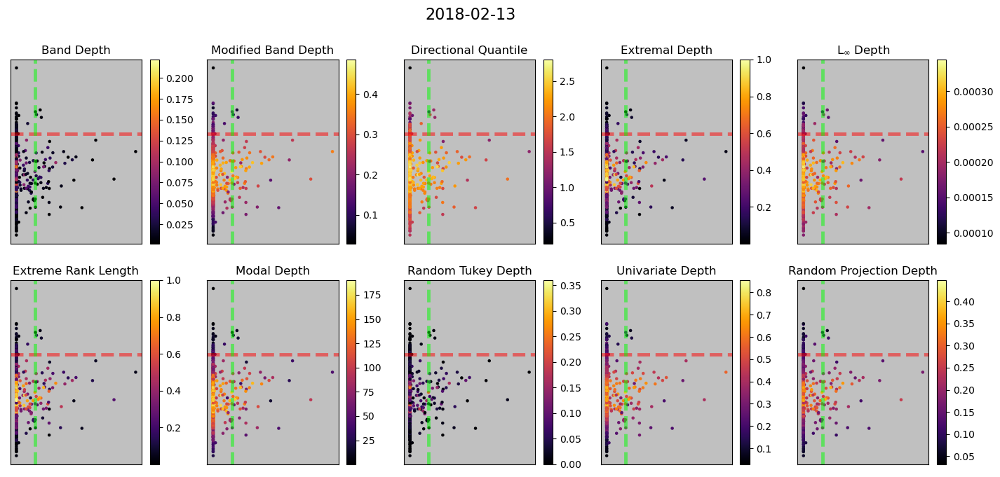

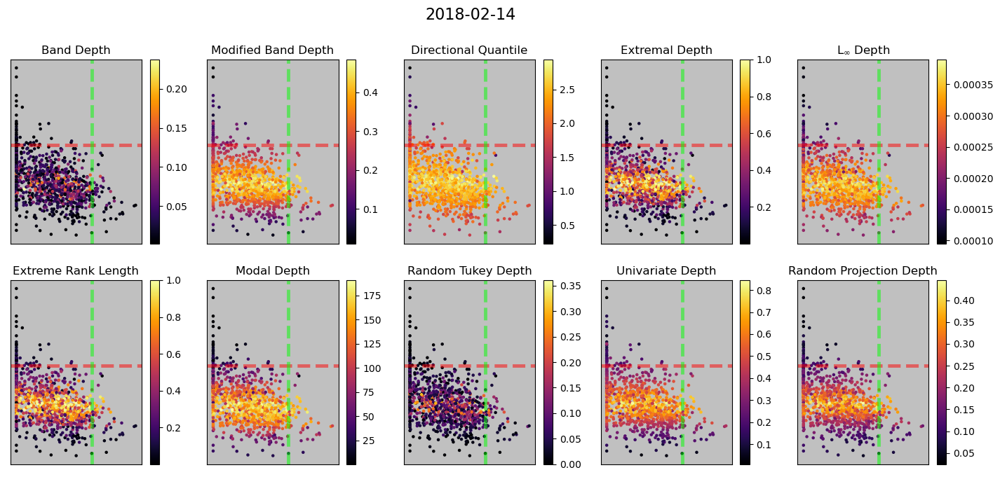

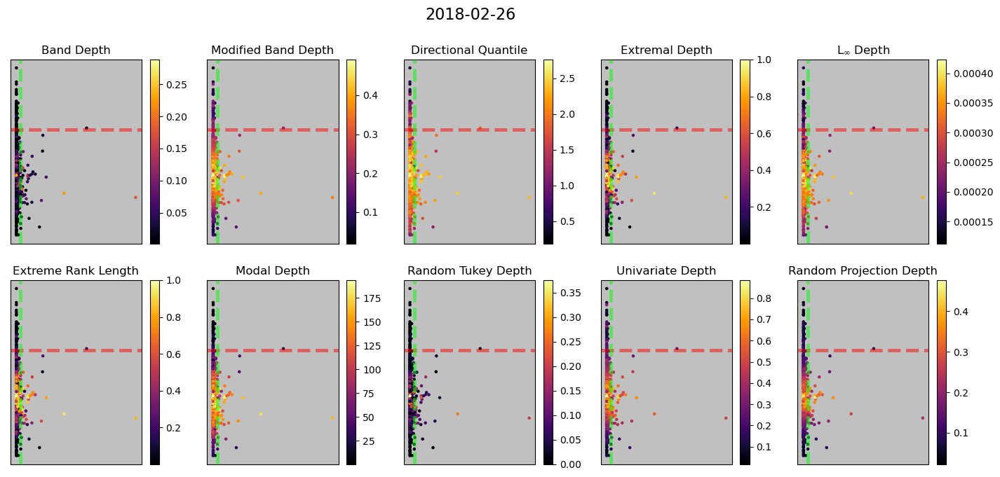

...

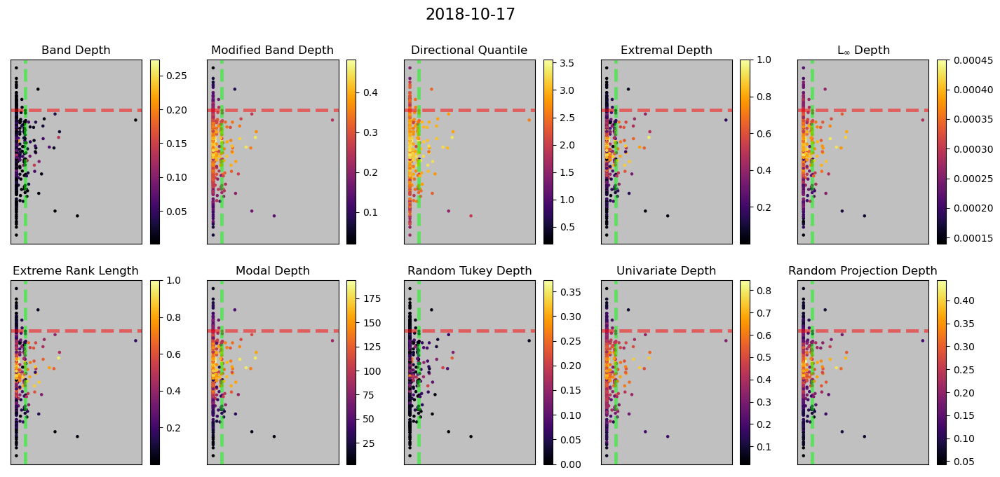

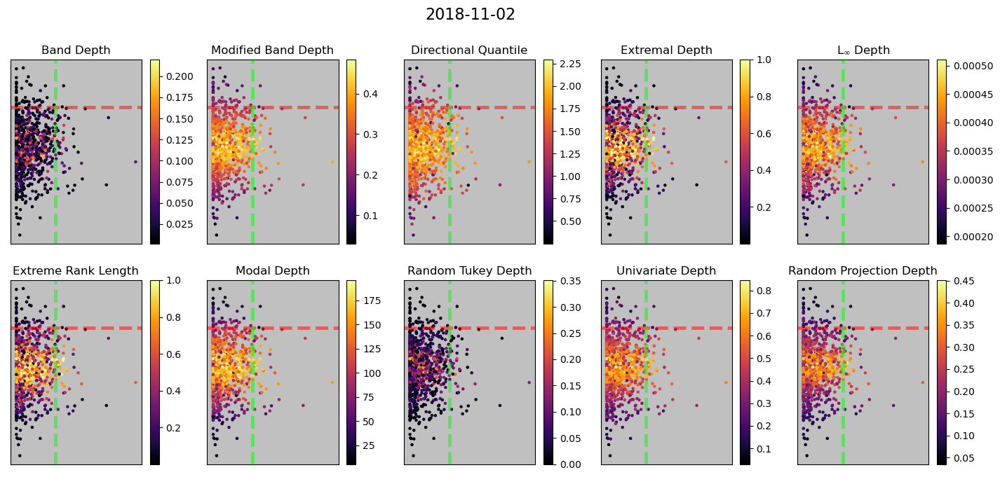

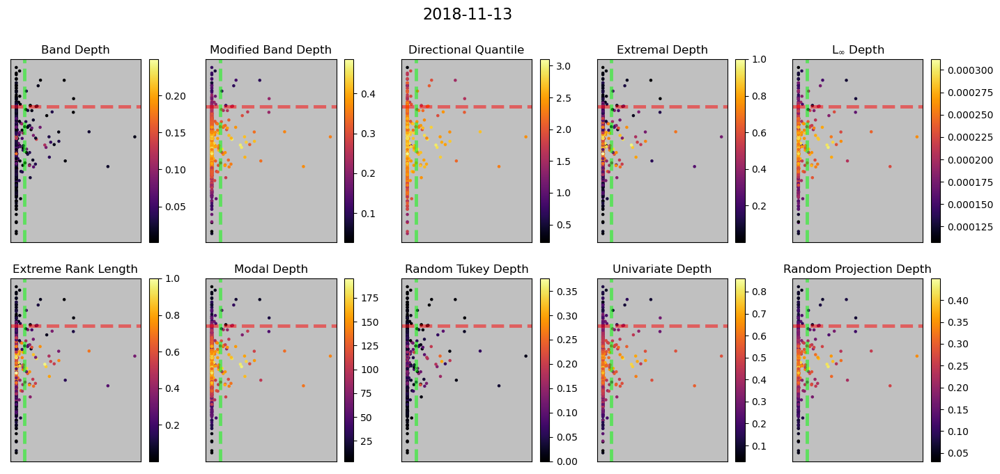

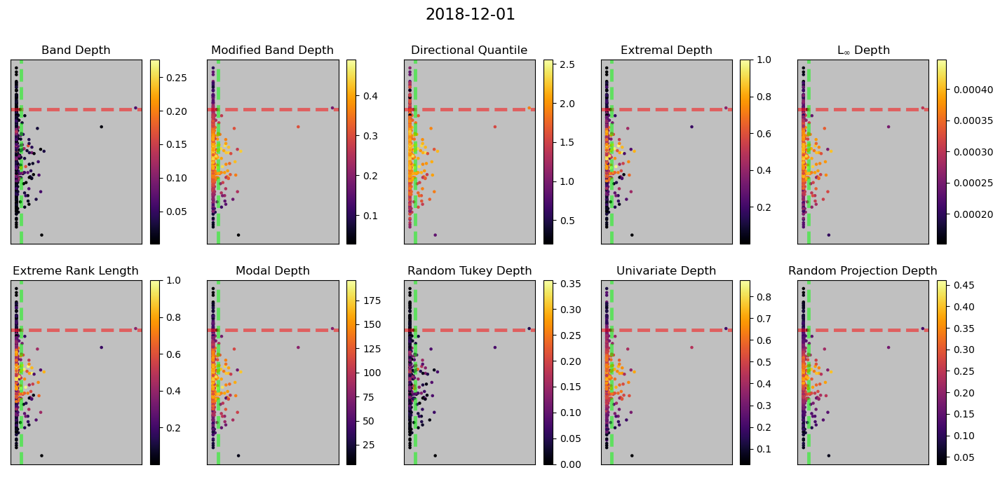

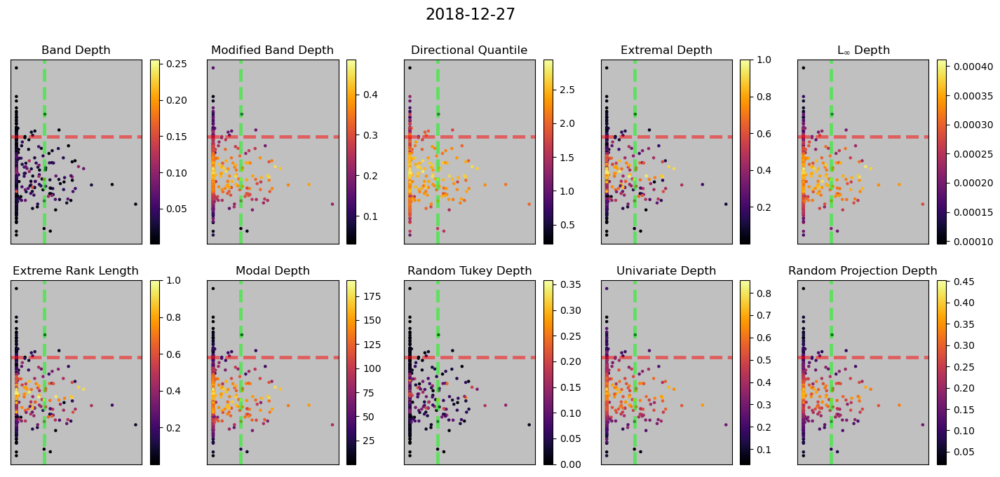

In [498]:
i_feature = 0
i_vatic   = 2

for i_day in range(N_days):


    y_ = Y_[:, i_vatic, i_day]
    x_ = np.mean(X_[i_feature][..., i_day], axis = 1)
    #x_ = np.max(X_[i_feature][..., i_day], axis = 1) - np.min(X_[i_feature][..., i_day], axis = 1) #+ np.mean(X_[i_feature][..., i_day], axis = 1)

    #x_ = np.sum(np.diff(X_[i_feature][..., i_day], 2), axis = 1)

    idx_extreme_ = np.argsort(y_)
    idx_area_    = np.argsort(x_)

    y = y_[idx_extreme_][-50]
    x = x_[idx_area_][-50]
        
    plt.figure(figsize = (17.5, 7.5))
    plt.suptitle(dates_[i_day], fontsize = 16)

    for i_metric in range(N_metrics):

        ax = plt.subplot2grid( (2, 5), idx_plot_[i_metric] )
#
        z_ = aggFunAUC_[i_metric, i_feature, i_day, :]
        #z_ = aggFunDiff_[i_metric, i_feature, i_day, :]

        #z_ = 1. - z_/z_.sum()
            
        ax.set_title(metrics_[i_metric], fontsize = 12)
        ax.axhline(x, color     = 'red', 
                       linestyle = '--', 
                       linewidth = 3.5, 
                       alpha     = 0.5)

        
        ax.axvline(y, color     = 'lime', 
                       linestyle = '--', 
                       linewidth = 3.5, 
                       alpha     = 0.5)
        
        ax.set_xticks([],[])
        ax.set_yticks([],[])

        im = ax.scatter(y_, x_, c = z_, s = 5., cmap = 'inferno')
        
        # add the bar
        cbar = plt.colorbar(im)

    plt.show()

In [505]:
i_feature = 0
i_vatic   = 2

N_extreme = 50
N_sel     = 200
N_area    = 800

score_fdepth_ = np.zeros((N_days, N_metrics))
score_bl_     = np.zeros((N_days,))
score_sample_ = np.zeros((N_days,))
N_extremes_ = np.zeros((N_days,), dtype = int)

for i_day in range(N_days):

    y_ = Y_[:, i_vatic, i_day]
    x_ = np.sum(X_[i_feature][..., i_day], axis = 1)
    
    N_extremes_[i_day] = int(np.sum(y_ > 0.))
    #if N_extremes_[i_day] > N_sel: N_extremes_[i_day] = N_sel
        
    idx_extreme_ = np.argsort(y_)[::-1]
    idx_auc_     = np.argsort(x_)[::-1]
    
    #score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extreme], idx_area_[:N_sel]).shape[0]
    score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_auc_[:N_sel]).shape[0]/N_extremes_[i_day]

    ranks_ = []
    for i_metric in range(N_metrics):

        idx_depth_ = np.argsort(aggFunAUC_[i_metric, i_feature, i_day, idx_auc_[:N_area]])
        #idx_depth_ = np.argsort(aggFunDiff[i_metric, i_feature, i_day, idx_auc_[:N_area]])

        ranks_.append(idx_area_[:N_area][idx_depth_[:N_sel]])
        
        #score_fdepth_[i_day, i_metric] = np.intersect1d(idx_extreme_[:N_extreme], ranks_[-1]).shape[0]
        score_fdepth_[i_day, i_metric] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_auc_[:N_area][idx_depth_[:N_sel]]).shape[0]/N_extremes_[i_day]
        
    ranks_ = np.stack(ranks_)
    for i in range(N_area):
        idx_ensamble_ = np.unique(ranks_[:, :i])
        if idx_ensamble_.shape[0] == N_sel:
            break
        if idx_ensamble_.shape[0] > N_sel:
            idx_ensamble_ = idx_ensamble_[:N_sel]
            break
    
    #score_sample_[i_day] = np.intersect1d(idx_extreme_[:N_extreme], idx_ensamble_).shape[0]
    score_sample_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_ensamble_).shape[0]/N_extremes_[i_day]

name = 'e{}v{}f{}auc{}s{}.png'.format(N_extreme, i_vatic, i_feature, N_sel, N_area)
print(name)

caption_ = "{} Events | -Feature: {} -# AUC Filtered: {} -# Selected: {}".format(vatic_[i_vatic], features_[i_feature], N_area, N_sel)

df_ = np.concatenate([N_extremes_[:, np.newaxis], score_bl_[:, np.newaxis], score_fdepth_, score_sample_[:, np.newaxis]], axis = 1)
df_ = np.nan_to_num(df_, nan = 1.)
df_ = np.concatenate([df_, np.mean(df_, axis = 0)[np.newaxis, :], np.median(df_, axis = 0)[np.newaxis, :]], axis = 0)   
df_ = pd.DataFrame(df_, columns = ['No. Scen.'] + ['AUC'] +  metrics_ + ['Ensamble'] , index = dates_.tolist() + ['Mean', 'Median'])
print(caption_)
display(df_)

e50v2f0auc200s800.png
Renewable Energy Curtailment Events | -Feature: Load -# AUC Filtered: 800 -# Selected: 200


/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_29858/2572777438.py:25: RuntimeWarning: invalid value encountered in long_scalars
  score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_auc_[:N_sel]).shape[0]/N_extremes_[i_day]
/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_29858/2572777438.py:36: RuntimeWarning: invalid value encountered in long_scalars
  score_fdepth_[i_day, i_metric] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_auc_[:N_area][idx_depth_[:N_sel]]).shape[0]/N_extremes_[i_day]
/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_29858/2572777438.py:48: RuntimeWarning: invalid value encountered in long_scalars
  score_sample_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_ensamble_).shape[0]/N_extremes_[i_day]


,No. Scen.,AUC,Band Depth,Modified Band Depth,Directional Quantile,Extremal Depth,L$_\infty$ Depth,Extreme Rank Length,Modal Depth,Random Tukey Depth,Univariate Depth,Random Projection Depth,Ensamble
2018-01-02,501.00,0.383234,0.295409,0.353293,0.327345,0.323353,0.343313,0.325349,0.355289,0.315369,0.355289,0.363273,0.213573
2018-01-20,578.00,0.091696,0.155709,0.108997,0.134948,0.131488,0.112457,0.131488,0.103806,0.129758,0.115917,0.114187,0.192042
2018-02-13,115.00,0.200000,0.400000,0.313043,0.339130,0.339130,0.321739,0.330435,0.295652,0.339130,0.304348,0.269565,0.191304
2018-02-14,801.00,0.128589,0.166042,0.141074,0.154806,0.151061,0.141074,0.151061,0.141074,0.159800,0.141074,0.141074,0.194757
2018-02-26,318.00,0.113208,0.150943,0.128931,0.132075,0.141509,0.128931,0.141509,0.116352,0.179245,0.135220,0.116352,0.226415
2018-03-14,129.00,0.100775,0.224806,0.147287,0.131783,0.116279,0.116279,0.116279,0.124031,0.193798,0.147287,0.116279,0.224806
2018-04-01,79.00,0.253165,0.227848,0.253165,0.227848,0.227848,0.291139,0.227848,0.253165,0.240506,0.265823,0.240506,0.177215
2018-04-09,36.00,0.333333,0.333333,0.333333,0.305556,0.305556,0.333333,0.305556,0.333333,0.305556,0.305556,0.305556,0.166667
2018-04-24,191.00,0.146597,0.167539,0.172775,0.157068,0.167539,0.172775,0.167539,0.178010,0.178010,0.162304,0.157068,0.183246
2018-05-10,368.00,0.165761,0.184783,0.182065,0.171196,0.171196,0.206522,0.171196,0.179348,0.195652,0.179348,0.171196,0.190217


In [506]:
i_feature = 0
i_vatic   = 2

N_extreme = 50
N_sel     = 200
N_area    = 800

score_fdepth_ = np.zeros((N_days, N_metrics))
score_bl_     = np.zeros((N_days,))
score_sample_ = np.zeros((N_days,))
N_extremes_ = np.zeros((N_days,), dtype = int)

for i_day in range(N_days):

    y_ = Y_[:, i_vatic, i_day]
    x_ = np.sum(X_[i_feature][..., i_day], axis = 1)
    
    N_extremes_[i_day] = int(np.sum(y_ > 0.))
    #if N_extremes_[i_day] > N_sel: N_extremes_[i_day] = N_sel
        
    idx_extreme_ = np.argsort(y_)[::-1]
    idx_area_    = np.argsort(x_)[::-1]
    
    #score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extreme], idx_area_[:N_sel]).shape[0]
    score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_area_[:N_sel]).shape[0]/N_extremes_[i_day]


    for i_metric in range(N_metrics):
        ranks_ = []

        # for i_features in [4]:
        #     if (i_features == 1) or (i_features == 2) or (i_features == 3):
        #         idx_depth_ = np.argsort(aggFunAUC_[i_metric, i_features, i_day, idx_area_[:N_area]])
        #     else:
        #         idx_depth_ = np.argsort(aggFunAUC_[i_metric, i_features, i_day, idx_area_[:N_area]])
        #     ranks_.append(idx_area_[:N_area][idx_depth_[:N_sel]])
            
        idx_depth_ = np.argsort(aggFunAUC_[i_metric, i_features, i_day, idx_area_[:N_area]])
        ranks_.append(idx_area_[:N_area][idx_depth_[:N_sel]])

        ranks_ = np.stack(ranks_)

        for i in range(N_area):
            idx_ensamble_ = np.unique(ranks_[:, :i])
            if idx_ensamble_.shape[0] == N_sel:
                break
            if idx_ensamble_.shape[0] > N_sel:
                idx_ensamble_ = idx_ensamble_[:N_sel]
                break

            
        #score_sample_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_ensamble_).shape[0]/N_extremes_[i_day]
        score_fdepth_[i_day, i_metric] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_area_[:N_area][idx_depth_[:N_sel]]).shape[0]/N_extremes_[i_day]


name = 'e{}v{}f{}auc{}s{}.png'.format(N_extreme, i_vatic, i_feature, N_sel, N_area)
print(name)

caption_ = "{} Events | -Feature: {} -# AUC Filtered: {} -# Selected: {}".format(vatic_[i_vatic], features_[i_feature], N_area, N_sel)

df_ = np.concatenate([N_extremes_[:, np.newaxis], score_bl_[:, np.newaxis], score_fdepth_], axis = 1)
df_ = np.nan_to_num(df_, nan = 1.)
df_ = np.concatenate([df_, np.mean(df_, axis = 0)[np.newaxis, :], np.median(df_, axis = 0)[np.newaxis, :]], axis = 0)   
df_ = pd.DataFrame(df_, columns = ['No. Scen.'] + ['AUC'] +  metrics_, index = dates_.tolist() + ['Mean', 'Median'])
print(caption_)
display(df_)

e50v2f0auc200s800.png
Renewable Energy Curtailment Events | -Feature: Load -# AUC Filtered: 800 -# Selected: 200


/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_29858/396919715.py:25: RuntimeWarning: invalid value encountered in long_scalars
  score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_area_[:N_sel]).shape[0]/N_extremes_[i_day]
/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_29858/396919715.py:53: RuntimeWarning: invalid value encountered in long_scalars
  score_fdepth_[i_day, i_metric] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_area_[:N_area][idx_depth_[:N_sel]]).shape[0]/N_extremes_[i_day]


,No. Scen.,AUC,Band Depth,Modified Band Depth,Directional Quantile,Extremal Depth,L$_\infty$ Depth,Extreme Rank Length,Modal Depth,Random Tukey Depth,Univariate Depth,Random Projection Depth
2018-01-02,501.00,0.383234,0.301397,0.347305,0.323353,0.327345,0.353293,0.327345,0.357285,0.295409,0.345309,0.363273
2018-01-20,578.00,0.091696,0.153979,0.110727,0.141869,0.141869,0.119377,0.143599,0.102076,0.140138,0.114187,0.115917
2018-02-13,115.00,0.200000,0.347826,0.269565,0.286957,0.286957,0.313043,0.286957,0.295652,0.330435,0.269565,0.269565
2018-02-14,801.00,0.128589,0.183521,0.151061,0.171036,0.171036,0.153558,0.171036,0.149813,0.177278,0.148564,0.149813
2018-02-26,318.00,0.113208,0.172956,0.132075,0.141509,0.144654,0.116352,0.141509,0.119497,0.150943,0.119497,0.113208
2018-03-14,129.00,0.100775,0.232558,0.186047,0.232558,0.217054,0.201550,0.217054,0.186047,0.186047,0.178295,0.193798
2018-04-01,79.00,0.253165,0.265823,0.151899,0.189873,0.189873,0.164557,0.189873,0.189873,0.227848,0.151899,0.177215
2018-04-09,36.00,0.333333,0.361111,0.277778,0.305556,0.305556,0.388889,0.305556,0.361111,0.250000,0.222222,0.250000
2018-04-24,191.00,0.146597,0.178010,0.151832,0.157068,0.146597,0.151832,0.146597,0.157068,0.146597,0.146597,0.130890
2018-05-10,368.00,0.165761,0.171196,0.179348,0.168478,0.171196,0.154891,0.171196,0.149457,0.149457,0.184783,0.171196


# Zonal-Level Extremality Detection

In [15]:
path_to_data_ = r'/Users/Guille/Desktop/extreme_scenarios/data/'

with open(path_to_data_ + 'ProcessedZonalTexas.pkl', 'rb') as handle:
    zonalData_ = pickle.load(handle)
    
L_ = zonalData_[0]
S_ = zonalData_[1]
W_ = zonalData_[2]
G_ = zonalData_[3]
N_ = zonalData_[4]
Y_ = zonalData_[5]
X_ = [L_, S_, W_, G_, N_]
print(L_.shape, S_.shape, W_.shape, G_.shape, N_.shape, Y_.shape)

with open(path_to_data + 'AreaZonalFuntionalDepths.pkl', 'rb') as handle:
    zonalFunAUC_ = pickle.load(handle)

with open(path_to_data + 'DiffZonalFuntionalDepths.pkl', 'rb') as handle:
    zonalFunDiff_ = pickle.load(handle)
print(zonalFunAUC_.shape, zonalFunDiff_.shape)

N_metrics, N_features, N_zones, N_days, N_scenarios = zonalFunAUC_.shape
print(N_metrics, N_features, N_zones, N_days, N_scenarios)

idx_plot_ = []
for i in range(2):
    for j in range(5):
        idx_plot_.append((i, j))
        
metrics_ = ['Band Depth', 'Modified Band Depth', 'Directional Quantile', 'Extremal Depth', 'L$_\infty$ Depth', 
            'Extreme Rank Length', 'Modal Depth', 'Random Tukey Depth', 'Univariate Depth', 'Random Projection Depth']

dates_ = ['2018-02-14', '2018-02-13', '2018-08-08', '2018-06-04', '2018-05-25',
          '2018-11-13', '2018-09-14', '2018-04-24', '2018-05-10', '2018-04-01',
          '2018-12-27', '2018-04-09', '2018-07-22', '2018-07-24', '2018-03-14',
          '2018-01-02', '2018-06-30', '2018-02-26', '2018-12-01', '2018-10-17',
          '2018-11-02', '2018-10-02', '2018-09-04', '2018-08-18', '2018-01-20']
idx_dates_ = np.argsort(dates_)
dates_     = np.array(dates_)[idx_dates_]
print(dates_)

features_ = ['Load', 'Solar Generation', 'Wind Generation', 'Renewable Energy Generation', 'Net Load']
vatic_    = ['Variable Costs', 'Load Shedding', 'Renewable Energy Curtailment', 'Reserve Shortfall']

zones_ = ['Coast', 'East', 'Far_West', 'North', 'North_Central', 'South', 'South_Central', 'West']

# # Sort dates
# idx_dates_ = np.argsort(dates_)
# dates_     = np.array(dates_)[idx_dates_]
# # Apply shorting to data
# zonalFunAUC_  = zonalFunAUC_[..., idx_dates_, :]
# zonalFunDiff_ = zonalFunDiff_[..., idx_dates_, :]
# print(zonalFunAUC_.shape, zonalFunDiff_.shape)
# L_ = L_[..., idx_dates_]
# S_ = S_[..., idx_dates_]
# W_ = W_[..., idx_dates_]
# G_ = G_[..., idx_dates_]
# N_ = N_[..., idx_dates_]
# Y_ = Y_[..., idx_dates_]
# X_ = [L_, S_, W_, G_, N_]
# print(L_.shape, S_.shape, W_.shape, G_.shape, N_.shape, Y_.shape)

(24, 1000, 8, 25) (24, 1000, 8, 25) (24, 1000, 8, 25) (24, 1000, 8, 25) (24, 1000, 8, 25) (1000, 4, 25)
(10, 5, 8, 25, 1000) (10, 5, 8, 25, 1000)
10 5 8 25 1000
['2018-01-02' '2018-01-20' '2018-02-13' '2018-02-14' '2018-02-26'
 '2018-03-14' '2018-04-01' '2018-04-09' '2018-04-24' '2018-05-10'
 '2018-05-25' '2018-06-04' '2018-06-30' '2018-07-22' '2018-07-24'
 '2018-08-08' '2018-08-18' '2018-09-04' '2018-09-14' '2018-10-02'
 '2018-10-17' '2018-11-02' '2018-11-13' '2018-12-01' '2018-12-27']


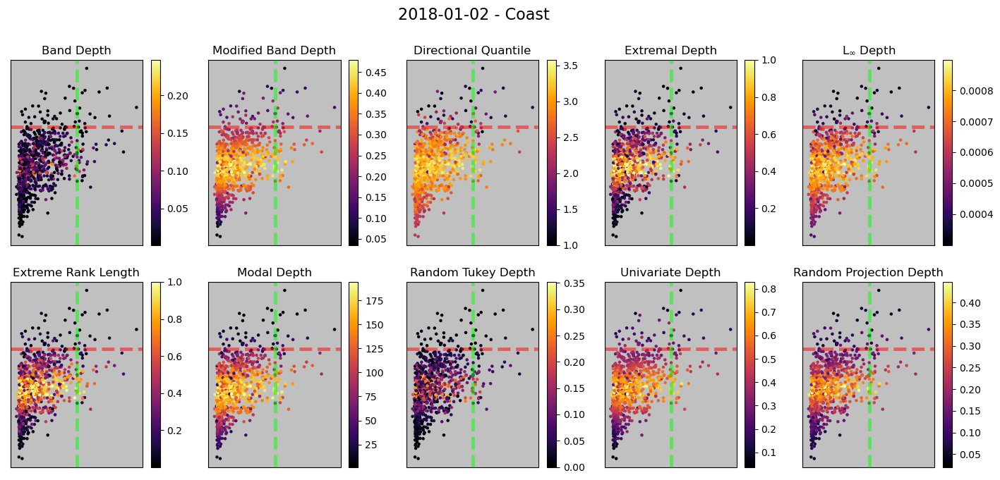

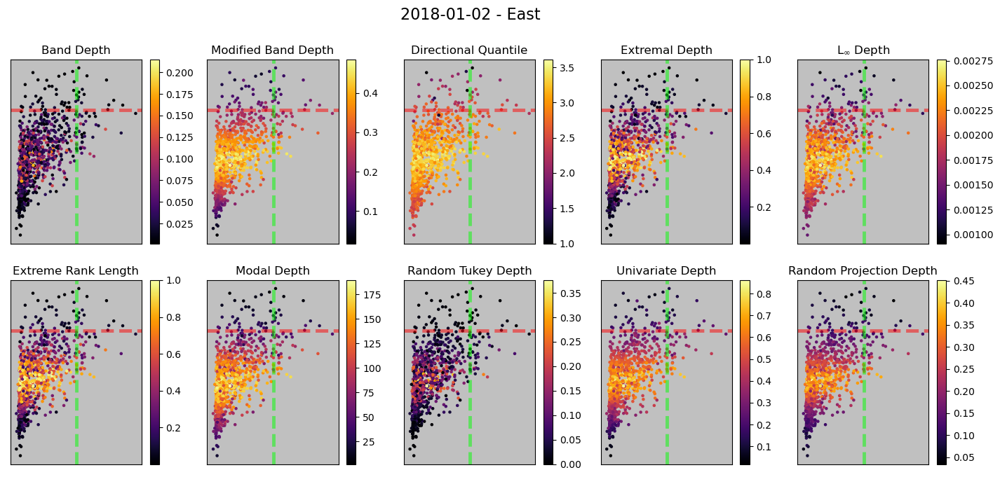

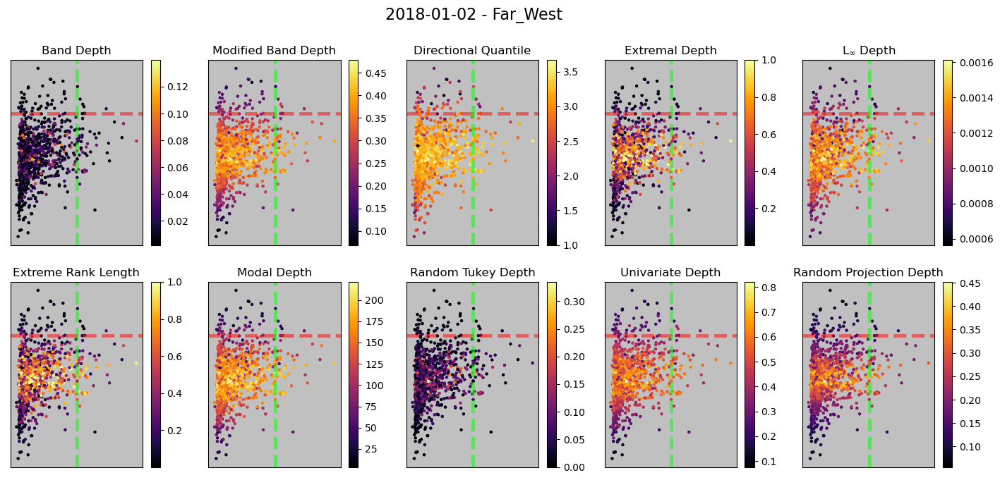

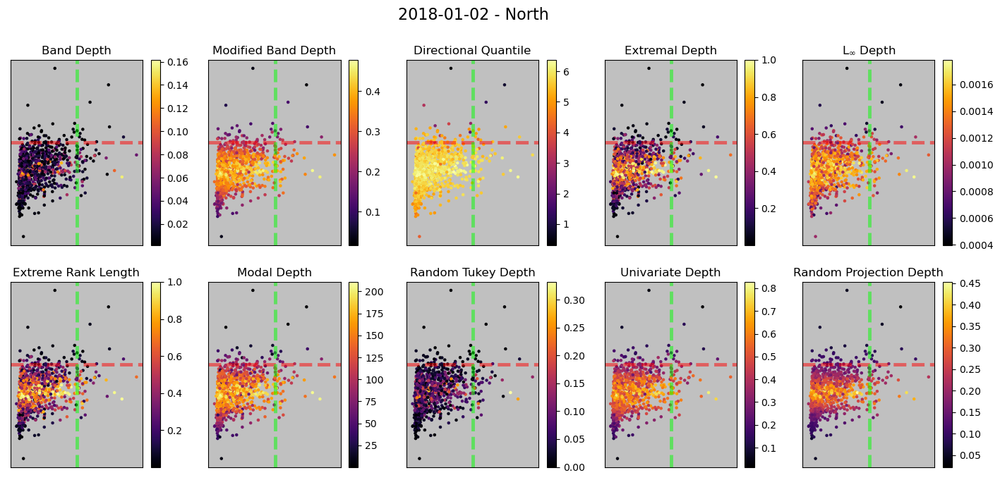

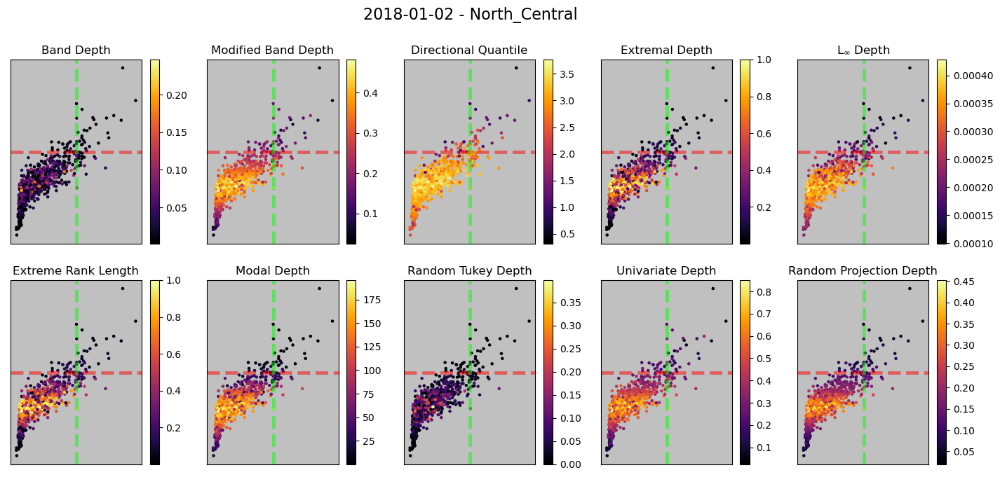

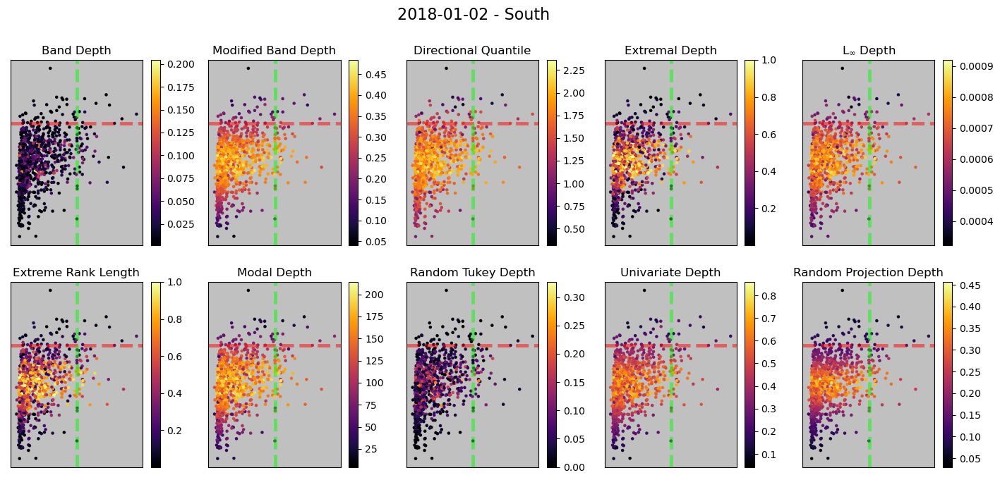

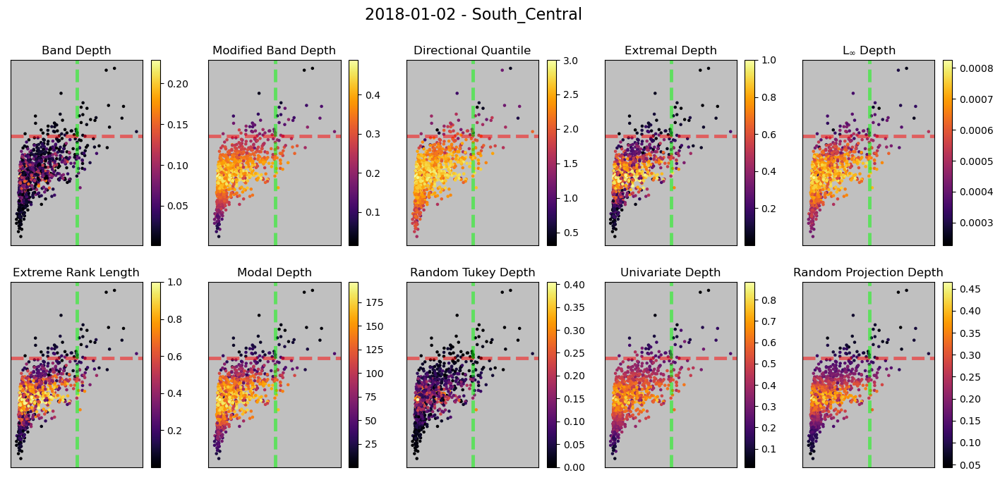

KeyboardInterrupt: 

In [17]:
i_feature = 4
i_vatic   = 3

for i_day in range(N_days):
    
    for i_zone in range(N_zones):

        y_ = Y_[:, i_vatic, i_day]
        x_ = np.mean(X_[i_feature][..., i_zone, i_day], axis = 0)
        #x_ = np.sum(np.diff(X_[i_feature][..., i_day], 2), axis = 1)

        idx_extreme_ = np.argsort(y_)
        idx_auc_     = np.argsort(x_)

        y = y_[idx_extreme_][-50]
        x = x_[idx_auc_][-50]

        plt.figure(figsize = (17.5, 7.5))
        plt.suptitle(dates_[i_day] + ' - ' + zones_[i_zone], fontsize = 16)

        for i_metric in range(N_metrics):

            ax = plt.subplot2grid( (2, 5), idx_plot_[i_metric] )
    #
            z_ = zonalFunAUC_[i_metric, i_feature, i_zone, i_day, :]
            #z_ = fdiff_[i_metric, i_feature, i_zone, i_day, :]

            #z_ = 1. - z_/z_.sum()

            ax.set_title(metrics_[i_metric], fontsize = 12)
            ax.axhline(x, color     = 'red', 
                           linestyle = '--', 
                           linewidth = 3.5, 
                           alpha     = 0.5)


            ax.axvline(y, color     = 'lime', 
                           linestyle = '--', 
                           linewidth = 3.5, 
                           alpha     = 0.5)

            ax.set_xticks([],[])
            ax.set_yticks([],[])

            im = ax.scatter(y_, x_, c = z_, s = 5., cmap = 'inferno')

            # add the bar
            cbar = plt.colorbar(im)

    plt.show()

## Zonal Extreme Reserve Shortfall

In [459]:
i_feature = 4
i_vatic   = 0

N_extreme = 50
N_sel     = 200
N_area    = 500

score_fdepth_ = np.zeros((N_days, N_metrics))
score_bl_     = np.zeros((N_days,))
score_sample_ = np.zeros((N_days,))
N_extremes_ = np.zeros((N_days,), dtype = int)

idx_zones_ = [0, 1, 2, 3, 4, 5, 6, 7]
#idx_zones_ = [0, 2, 3, 4, 5, 6, 7]
#idx_zones_ = [2, 3, 4, 5, 7]


for i_day in range(N_days):

    y_ = Y_[:, i_vatic, i_day]
    idx_extreme_ = np.argsort(y_)[::-1]


    N_extremes_[i_day] = 50 #int(np.sum(y_ > 0.))
    

    auc_ranks_       = []
    all_depth_ranks_ = []
    for i_zone in range(len(idx_zones_)):

        x_       = np.mean(X_[i_feature][..., idx_zones_[i_zone], i_day], axis = 0)
        idx_auc_ = np.argsort(x_)[::-1]
        auc_ranks_.append(idx_auc_[:N_area])

        depth_ranks_ = []
        for i_metric in range(N_metrics):    
            idx_depth_ = np.argsort(zonalFunDiff_[i_metric, i_feature, idx_zones_[i_zone], i_day, idx_auc_[:N_area]])
            depth_ranks_.append(idx_auc_[:N_area][idx_depth_])
            
        all_depth_ranks_.append(np.stack(depth_ranks_))
                
    auc_ranks_ = np.stack(auc_ranks_)
    all_depth_ranks_ = np.stack(all_depth_ranks_)
    #print(auc_ranks_.shape, all_depth_ranks_.shape)

    for i in range(N_sel + 1):
        idx_auc_zone_ = np.unique(auc_ranks_[:, :i])
        if idx_auc_zone_.shape[0] == N_sel:
            break
        if idx_auc_zone_.shape[0] > N_sel:
            idx_auc_zone_ = idx_auc_zone_[:N_sel]
            break

    score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_auc_zone_).shape[0]/N_extremes_[i_day]

    all_idx_ensamble_ = []
    for i_metric in range(N_metrics):

        for i in range(N_sel):
            idx_ensamble_ = np.unique(all_depth_ranks_[:, i_metric, :i])
            if idx_ensamble_.shape[0] == N_sel:
                break
            if idx_ensamble_.shape[0] > N_sel:
                idx_ensamble_ = idx_ensamble_[:N_sel]
                break
        #print(idx_ensamble_.shape)
        score_fdepth_[i_day, i_metric] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_ensamble_).shape[0]/N_extremes_[i_day]


name = 'e{}v{}f{}auc{}s{}.png'.format(N_extreme, i_vatic, i_feature, N_sel, N_area)
print(name)

caption_ = "{} Events | -Feature: {} -# AUC Filtered: {} -# Selected: {}".format(vatic_[i_vatic], features_[i_feature], N_area, N_sel)

df_ = np.concatenate([N_extremes_[:, np.newaxis], score_bl_[:, np.newaxis], score_fdepth_], axis = 1)
df_ = np.nan_to_num(df_)
print(np.max(np.mean(df_, axis = 0)[2:]))
df_ = np.concatenate([df_, np.mean(df_, axis = 0)[np.newaxis, :], np.median(df_, axis = 0)[np.newaxis, :]], axis = 0)   
df_ = pd.DataFrame(df_, columns = ['No. Scen.'] + ['AUC'] +  metrics_, index = dates_.tolist() + ['Mean', 'Median'])
print(caption_)
display(df_)


e50v0f4auc200s500.png
0.5792
Variable Costs Events | -Feature: Net Load -# AUC Filtered: 500 -# Selected: 200


,No. Scen.,AUC,Band Depth,Modified Band Depth,Directional Quantile,Extremal Depth,L$_\infty$ Depth,Extreme Rank Length,Modal Depth,Random Tukey Depth,Univariate Depth,Random Projection Depth
2018-01-02,50.0,0.920,0.5000,0.700,0.6000,0.4600,0.5800,0.5400,0.6800,0.4800,0.6600,0.6200
2018-01-20,50.0,0.960,0.6800,0.700,0.6600,0.6400,0.5600,0.6800,0.6000,0.6600,0.6800,0.4000
2018-02-13,50.0,0.920,0.6200,0.660,0.6000,0.5800,0.6800,0.6400,0.7200,0.6200,0.6600,0.5800
2018-02-14,50.0,0.960,0.6200,0.660,0.5400,0.6000,0.5600,0.6600,0.5800,0.5000,0.6000,0.5200
2018-02-26,50.0,0.940,0.7000,0.720,0.6800,0.6600,0.6800,0.7000,0.7400,0.6400,0.6800,0.5800
2018-03-14,50.0,0.880,0.6000,0.700,0.6400,0.6400,0.6000,0.6400,0.6800,0.5800,0.7000,0.5200
2018-04-01,50.0,0.920,0.6600,0.680,0.7200,0.6600,0.6800,0.6600,0.7400,0.7000,0.6800,0.6400
2018-04-09,50.0,0.840,0.4800,0.560,0.5400,0.5200,0.5000,0.5400,0.6000,0.5800,0.5400,0.5600
2018-04-24,50.0,0.800,0.6000,0.600,0.5800,0.5600,0.6000,0.5200,0.6000,0.6600,0.6200,0.5400
2018-05-10,50.0,0.800,0.5800,0.540,0.6000,0.5600,0.5200,0.5800,0.5200,0.5600,0.5000,0.5600


## Zonal Energy Curtailment Detection

In [465]:
i_feature = 4
i_vatic   = 2

N_extreme = 50
N_sel     = 200
N_area    = 500

score_fdepth_ = np.zeros((N_days, N_metrics))
score_bl_     = np.zeros((N_days,))
score_sample_ = np.zeros((N_days,))
N_extremes_   = np.zeros((N_days,), dtype = int)

idx_zones_ = [2, 4, 6, 7]
#idx_zones_ = [0, 2, 3, 4, 5, 6, 7]
#idx_zones_ = [2, 3, 4, 5, 7]


for i_day in range(N_days):

    y_ = Y_[:, i_vatic, i_day]
    idx_extreme_ = np.argsort(y_)[::-1]


    N_extremes_[i_day] = int(np.sum(y_ > 0.))
    if N_extremes_[i_day] > N_sel:
        N_extremes_[i_day] = N_sel
    
    auc_ranks_       = []
    all_depth_ranks_ = []
    for i_zone in range(len(idx_zones_)):

        x_       = np.mean(X_[i_feature][..., idx_zones_[i_zone], i_day], axis = 0)
        idx_auc_ = np.argsort(x_)[::-1]
        auc_ranks_.append(idx_auc_[:N_area])

        depth_ranks_ = []
        for i_metric in range(N_metrics):    
            idx_depth_ = np.argsort(zonalFunAUC_[i_metric, i_feature, idx_zones_[i_zone], i_day, idx_auc_[:N_area]])
            #idx_depth_ = np.argsort(zonalFunDiff_[i_metric, i_feature, idx_zones_[i_zone], i_day, idx_auc_[:N_area]])
            depth_ranks_.append(idx_auc_[:N_area][idx_depth_])
            
        all_depth_ranks_.append(np.stack(depth_ranks_))
                
    auc_ranks_ = np.stack(auc_ranks_)
    all_depth_ranks_ = np.stack(all_depth_ranks_)
    #print(auc_ranks_.shape, all_depth_ranks_.shape)

    for i in range(N_sel + 1):
        idx_auc_zone_ = np.unique(auc_ranks_[:, :i])
        if idx_auc_zone_.shape[0] == N_sel:
            break
        if idx_auc_zone_.shape[0] > N_sel:
            idx_auc_zone_ = idx_auc_zone_[:N_sel]
            break

    score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_auc_zone_).shape[0]/N_extremes_[i_day]

    all_idx_ensamble_ = []
    for i_metric in range(N_metrics):

        for i in range(N_sel):
            idx_ensamble_ = np.unique(all_depth_ranks_[:, i_metric, :i])
            if idx_ensamble_.shape[0] == N_sel:
                break
            if idx_ensamble_.shape[0] > N_sel:
                idx_ensamble_ = idx_ensamble_[:N_sel]
                break
        #print(idx_ensamble_.shape)
        score_fdepth_[i_day, i_metric] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_ensamble_).shape[0]/N_extremes_[i_day]


name = 'e{}v{}f{}auc{}s{}.png'.format(N_extreme, i_vatic, i_feature, N_sel, N_area)
print(name)

caption_ = "{} Events | -Feature: {} -# AUC Filtered: {} -# Selected: {}".format(vatic_[i_vatic], features_[i_feature], N_area, N_sel)

df_ = np.concatenate([N_extremes_[:, np.newaxis], score_bl_[:, np.newaxis], score_fdepth_], axis = 1)
df_ = np.nan_to_num(df_, nan = 1.)
print(np.max(np.mean(df_, axis = 0)[2:]))
df_ = np.concatenate([df_, np.mean(df_, axis = 0)[np.newaxis, :], np.median(df_, axis = 0)[np.newaxis, :]], axis = 0)   
df_ = pd.DataFrame(df_, columns = ['No. Scen.'] + ['AUC'] +  metrics_, index = dates_.tolist() + ['Mean', 'Median'])
print(caption_)
display(df_)

e50v2f4auc200s500.png
0.4003424645008131
Renewable Energy Curtailment Events | -Feature: Net Load -# AUC Filtered: 500 -# Selected: 200


/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_29858/3275280098.py:56: RuntimeWarning: invalid value encountered in long_scalars
  score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_auc_zone_).shape[0]/N_extremes_[i_day]
/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_29858/3275280098.py:69: RuntimeWarning: invalid value encountered in long_scalars
  score_fdepth_[i_day, i_metric] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_ensamble_).shape[0]/N_extremes_[i_day]


,No. Scen.,AUC,Band Depth,Modified Band Depth,Directional Quantile,Extremal Depth,L$_\infty$ Depth,Extreme Rank Length,Modal Depth,Random Tukey Depth,Univariate Depth,Random Projection Depth
2018-01-02,200.00,0.535000,0.400000,0.535000,0.455000,0.465000,0.460000,0.465000,0.510000,0.440000,0.510000,0.535000
2018-01-20,200.00,0.070000,0.130000,0.090000,0.090000,0.090000,0.100000,0.085000,0.110000,0.105000,0.080000,0.085000
2018-02-13,115.00,0.269565,0.356522,0.330435,0.417391,0.339130,0.347826,0.339130,0.347826,0.321739,0.313043,0.339130
2018-02-14,200.00,0.105000,0.115000,0.090000,0.095000,0.095000,0.105000,0.100000,0.110000,0.105000,0.085000,0.095000
2018-02-26,200.00,0.120000,0.125000,0.135000,0.115000,0.135000,0.135000,0.130000,0.135000,0.130000,0.135000,0.120000
2018-03-14,129.00,0.116279,0.178295,0.124031,0.139535,0.139535,0.139535,0.139535,0.139535,0.162791,0.124031,0.124031
2018-04-01,79.00,0.151899,0.189873,0.202532,0.189873,0.202532,0.227848,0.189873,0.177215,0.202532,0.215190,0.164557
2018-04-09,36.00,0.333333,0.416667,0.444444,0.416667,0.361111,0.388889,0.361111,0.388889,0.361111,0.388889,0.333333
2018-04-24,191.00,0.094241,0.157068,0.120419,0.141361,0.136126,0.167539,0.130890,0.141361,0.162304,0.120419,0.115183
2018-05-10,200.00,0.175000,0.210000,0.150000,0.210000,0.205000,0.215000,0.205000,0.235000,0.230000,0.155000,0.185000


## Zonal Extreme Load Shedding Detection

In [464]:
i_feature = 0
i_vatic   = 1

N_extreme = 50
N_sel     = 200
N_area    = 500

score_fdepth_ = np.zeros((N_days, N_metrics))
score_bl_     = np.zeros((N_days,))
score_sample_ = np.zeros((N_days,))
N_extremes_ = np.zeros((N_days,), dtype = int)

idx_zones_ = [2, 4, 6, 7]

for i_day in range(N_days):

    y_ = Y_[:, i_vatic, i_day]
    idx_extreme_ = np.argsort(y_)[::-1]

    N_extremes_[i_day] = int(np.sum(y_ > 0.))
    if N_extremes_[i_day] > N_sel:
        N_extremes_[i_day] = N_sel

    auc_ranks_       = []
    all_depth_ranks_ = []
    for i_zone in range(len(idx_zones_)):

        x_       = np.mean(X_[i_feature][..., idx_zones_[i_zone], i_day], axis = 0)
        idx_auc_ = np.argsort(x_)[::-1]
        auc_ranks_.append(idx_auc_[:N_area])

        depth_ranks_ = []
        for i_metric in range(N_metrics):    
            idx_depth_ = np.argsort(zonalFunAUC_[i_metric, i_feature, idx_zones_[i_zone], i_day, idx_auc_[:N_area]])
            #idx_depth_ = np.argsort(zonalFunDiff_[i_metric, i_feature, idx_zones_[i_zone], i_day, idx_auc_[:N_area]])

            depth_ranks_.append(idx_auc_[:N_area][idx_depth_])
            
        all_depth_ranks_.append(np.stack(depth_ranks_))
                
    auc_ranks_ = np.stack(auc_ranks_)
    all_depth_ranks_ = np.stack(all_depth_ranks_)
    #print(auc_ranks_.shape, all_depth_ranks_.shape)

    for i in range(N_sel + 1):
        idx_auc_zone_ = np.unique(auc_ranks_[:, :i])
        if idx_auc_zone_.shape[0] == N_sel:
            break
        if idx_auc_zone_.shape[0] > N_sel:
            idx_auc_zone_ = idx_auc_zone_[:N_sel]
            break

    score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_auc_zone_).shape[0]/N_extremes_[i_day]

    all_idx_ensamble_ = []
    for i_metric in range(N_metrics):

        for i in range(N_sel):
            idx_ensamble_ = np.unique(all_depth_ranks_[:, i_metric, :i])
            if idx_ensamble_.shape[0] == N_sel:
                break
            if idx_ensamble_.shape[0] > N_sel:
                idx_ensamble_ = idx_ensamble_[:N_sel]
                break
        #print(idx_ensamble_.shape)
        score_fdepth_[i_day, i_metric] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_ensamble_).shape[0]/N_extremes_[i_day]


name = 'e{}v{}f{}auc{}s{}.png'.format(N_extreme, i_vatic, i_feature, N_sel, N_area)
print(name)

caption_ = "{} Events | -Feature: {} -# AUC Filtered: {} -# Selected: {}".format(vatic_[i_vatic], features_[i_feature], N_area, N_sel)

df_ = np.concatenate([N_extremes_[:, np.newaxis], score_bl_[:, np.newaxis], score_fdepth_], axis = 1)
df_ = np.nan_to_num(df_, nan = 1.)
print(np.max(np.mean(df_, axis = 0)[2:]))
df_ = np.concatenate([df_, np.mean(df_, axis = 0)[np.newaxis, :], np.median(df_, axis = 0)[np.newaxis, :]], axis = 0)   
df_ = pd.DataFrame(df_, columns = ['No. Scen.'] + ['AUC'] +  metrics_, index = dates_.tolist() + ['Mean', 'Median'])
print(caption_)
display(df_)

e50v1f0auc200s500.png
0.590693423882955
Load Shedding Events | -Feature: Load -# AUC Filtered: 500 -# Selected: 200


,No. Scen.,AUC,Band Depth,Modified Band Depth,Directional Quantile,Extremal Depth,L$_\infty$ Depth,Extreme Rank Length,Modal Depth,Random Tukey Depth,Univariate Depth,Random Projection Depth
2018-01-02,200.00,0.565000,0.495000,0.580000,0.535000,0.535000,0.550000,0.520000,0.535000,0.525000,0.580000,0.580000
2018-01-20,41.00,0.804878,0.731707,0.780488,0.853659,0.878049,0.878049,0.853659,0.853659,0.731707,0.731707,0.878049
2018-02-13,55.00,0.854545,0.781818,0.800000,0.945455,0.927273,0.927273,0.927273,0.927273,0.890909,0.745455,0.909091
2018-02-14,50.00,0.760000,0.740000,0.660000,0.740000,0.760000,0.840000,0.780000,0.800000,0.760000,0.640000,0.740000
2018-02-26,24.00,0.875000,0.833333,0.833333,0.916667,0.916667,0.875000,0.916667,0.833333,0.875000,0.791667,0.791667
2018-03-14,75.00,0.573333,0.560000,0.546667,0.600000,0.613333,0.560000,0.626667,0.586667,0.546667,0.546667,0.546667
2018-04-01,131.00,0.358779,0.312977,0.358779,0.335878,0.328244,0.312977,0.328244,0.320611,0.335878,0.366412,0.358779
2018-04-09,61.00,0.475410,0.409836,0.409836,0.442623,0.426230,0.426230,0.442623,0.459016,0.491803,0.426230,0.475410
2018-04-24,159.00,0.452830,0.389937,0.408805,0.433962,0.440252,0.459119,0.446541,0.427673,0.415094,0.408805,0.433962
2018-05-10,99.00,0.555556,0.555556,0.535354,0.535354,0.585859,0.535354,0.585859,0.545455,0.525253,0.545455,0.545455


# Aggregate and Zonal Extremality Detection

In [462]:
i_feature = 4
i_vatic   = 1

N_extreme = 50
N_sel     = 200
N_area    = 500

score_fdepth_ = np.zeros((N_days, N_metrics))
score_bl_     = np.zeros((N_days,))
score_sample_ = np.zeros((N_days,))
N_extremes_ = np.zeros((N_days,), dtype = int)

idx_zones_ = [2]

for i_day in range(N_days):

    y_ = Y_[:, i_vatic, i_day]
    idx_extreme_ = np.argsort(y_)[::-1]

    N_extremes_[i_day] = int(np.sum(y_ > 0.))
    if N_extremes_[i_day] > N_sel:
        N_extremes_[i_day] = N_sel

    zonalAUC_   = []
    zonalRanks_ = []
    for i_zone in range(len(idx_zones_)):

        x_       = zonalX_[i_feature][..., idx_zones_[i_zone], i_day]
        idx_auc_ = np.argsort(x_)[::-1]
        zonalAUC_.append(idx_auc_[:N_area])

        zonalRank_ = []
        for i_metric in range(N_metrics):    
            idx_depth_ = np.argsort(zonalFunAUC_[i_metric, i_feature, idx_zones_[i_zone], i_day, idx_auc_[:N_area]])
            #idx_depth_ = np.argsort(zonalFunDiff_[i_metric, i_feature, idx_zones_[i_zone], i_day, idx_auc_[:N_area]])

            zonalRank_.append(idx_auc_[:N_area][idx_depth_])
            
        zonalRanks_.append(np.stack(zonalRank_))
                
    zonalAUC_ = np.stack(zonalAUC_)
    zonalRanks_ = np.stack(zonalRanks_)
    #print(auc_ranks_.shape, all_depth_ranks_.shape)

    for i in range(N_sel + 1):
        idx_auc_zone_ = np.unique(zonalAUC_[:, :i])
        if idx_auc_zone_.shape[0] == N_sel:
            break
        if idx_auc_zone_.shape[0] > N_sel:
            idx_auc_zone_ = idx_auc_zone_[:N_sel]
            break

    score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_auc_zone_).shape[0]/N_extremes_[i_day]
    
    x_ = np.mean(np.sum(X_[i_feature], axis = 2)[..., i_day], axis = 0)
    
    idx_auc_  = np.argsort(x_)[::-1]
    aggRanks_ = []
    for i_metric in range(N_metrics):
        idx_depth_ = np.argsort(aggFunAUC_[i_metric, i_feature, i_day, idx_auc_[:N_area]])
        #idx_depth_ = np.argsort(aggFunDiff_[i_metric, i_feature, i_day, idx_area_[:N_area]])
        aggRanks_.append(idx_auc_[:N_area][idx_depth_])
    aggRanks_ = np.stack(aggRanks_)
    
    ensambleRanks_ = np.concatenate((aggRanks_[np.newaxis, ...], zonalRanks_), axis = 0)
        
    for i_metric in range(N_metrics):
        for i in range(N_sel):
            idx_ensamble_ = np.unique(ensambleRanks_[:, i_metric, :i])
            if idx_ensamble_.shape[0] == N_sel:
                break
            if idx_ensamble_.shape[0] > N_sel:
                idx_ensamble_ = idx_ensamble_[:N_sel]
                break
        #print(idx_ensamble_.shape)
        score_fdepth_[i_day, i_metric] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_ensamble_).shape[0]/N_extremes_[i_day]


name = 'e{}v{}f{}auc{}s{}.png'.format(N_extreme, i_vatic, i_feature, N_sel, N_area)
print(name)

caption_ = "{} Events | -Feature: {} -# AUC Filtered: {} -# Selected: {}".format(vatic_[i_vatic], features_[i_feature], N_area, N_sel)

df_ = np.concatenate([N_extremes_[:, np.newaxis], score_bl_[:, np.newaxis], score_fdepth_], axis = 1)
df_ = np.nan_to_num(df_, nan = 1.)
print(np.max(np.mean(df_, axis = 0)[2:]))
df_ = np.concatenate([df_, np.mean(df_, axis = 0)[np.newaxis, :], np.median(df_, axis = 0)[np.newaxis, :]], axis = 0)   
df_ = pd.DataFrame(df_, columns = ['No. Scen.'] + ['AUC'] +  metrics_, index = dates_.tolist() + ['Mean', 'Median'])
print(caption_)
display(df_)

e50v1f4auc200s500.png
0.6772299544973903
Load Shedding Events | -Feature: Net Load -# AUC Filtered: 500 -# Selected: 200


,No. Scen.,AUC,Band Depth,Modified Band Depth,Directional Quantile,Extremal Depth,L$_\infty$ Depth,Extreme Rank Length,Modal Depth,Random Tukey Depth,Univariate Depth,Random Projection Depth
2018-01-02,200.00,0.375000,0.510000,0.605000,0.535000,0.540000,0.610000,0.535000,0.620000,0.545000,0.595000,0.630000
2018-01-20,41.00,0.707317,0.829268,0.829268,0.853659,0.878049,0.878049,0.853659,0.853659,0.853659,0.780488,0.853659
2018-02-13,55.00,0.581818,0.781818,0.763636,0.890909,0.890909,0.872727,0.872727,0.872727,0.781818,0.727273,0.854545
2018-02-14,50.00,0.520000,0.800000,0.760000,0.860000,0.840000,0.820000,0.820000,0.780000,0.720000,0.740000,0.760000
2018-02-26,24.00,0.500000,0.791667,0.916667,0.875000,0.875000,0.916667,0.875000,0.916667,0.916667,0.875000,0.875000
2018-03-14,75.00,0.346667,0.666667,0.653333,0.853333,0.800000,0.760000,0.800000,0.746667,0.626667,0.600000,0.706667
2018-04-01,131.00,0.458015,0.427481,0.496183,0.511450,0.503817,0.435115,0.511450,0.458015,0.435115,0.496183,0.480916
2018-04-09,61.00,0.426230,0.622951,0.606557,0.704918,0.704918,0.688525,0.704918,0.672131,0.606557,0.573770,0.573770
2018-04-24,159.00,0.490566,0.553459,0.578616,0.591195,0.616352,0.641509,0.622642,0.610063,0.628931,0.559748,0.559748
2018-05-10,99.00,0.565657,0.606061,0.666667,0.747475,0.737374,0.656566,0.737374,0.676768,0.676768,0.656566,0.666667


# Aggregate and Zonal Processing

In [283]:
aggL_ = np.mean(aggData_[0], axis = 1)[:, np.newaxis, :]
aggS_ = np.mean(aggData_[1], axis = 1)[:, np.newaxis, :]
aggW_ = np.mean(aggData_[2], axis = 1)[:, np.newaxis, :]
aggG_ = np.mean(aggData_[3], axis = 1)[:, np.newaxis, :]
aggN_ = np.mean(aggData_[4], axis = 1)[:, np.newaxis, :]
print(aggL_.shape, aggS_.shape, aggW_.shape, aggG_.shape, aggN_.shape)

zonalL_ = np.mean(zonalData_[0], axis = 0)
zonalS_ = np.mean(zonalData_[1], axis = 0)
zonalW_ = np.mean(zonalData_[2], axis = 0)
zonalG_ = np.mean(zonalData_[3], axis = 0)
zonalN_ = np.mean(zonalData_[4], axis = 0)
print(zonalL_.shape, zonalS_.shape, zonalW_.shape, zonalG_.shape, zonalN_.shape)
zonalX_ = [zonalL_, zonalS_, zonalW_, zonalG_, zonalN_]

L_ = np.concatenate((aggL_, zonalL_), axis = 1)
S_ = np.concatenate((aggS_, zonalS_), axis = 1)
W_ = np.concatenate((aggW_, zonalW_), axis = 1)
G_ = np.concatenate((aggG_, zonalG_), axis = 1)
N_ = np.concatenate((aggN_, zonalN_), axis = 1)
print(L_.shape, S_.shape, W_.shape, G_.shape, N_.shape)

X_ = [L_, S_, W_, G_, N_]
Y_ = zonalData_[5]


funAUC_ = np.concatenate((aggFunAUC_[:, :, np.newaxis, :, :], zonalFunAUC_), axis = 2)
funDiff_ = np.concatenate((aggFunDiff_[:, :, np.newaxis, :, :], zonalFunDiff_), axis = 2)
print(funAUC_.shape, funDiff_.shape, aggFunAUC_.shape, zonalFunAUC_.shape)

(1000, 1, 25) (1000, 1, 25) (1000, 1, 25) (1000, 1, 25) (1000, 1, 25)
(1000, 8, 25) (1000, 8, 25) (1000, 8, 25) (1000, 8, 25) (1000, 8, 25)
(1000, 9, 25) (1000, 9, 25) (1000, 9, 25) (1000, 9, 25) (1000, 9, 25)
(10, 5, 9, 25, 1000) (10, 5, 9, 25, 1000) (10, 5, 25, 1000) (10, 5, 8, 25, 1000)


# Aggregated and Zonal quantifing total energy

In [320]:
N_extreme = 50
N_ttl_sel = 250
N_area    = 1000

score_fdepth_ = np.zeros((N_days, N_metrics))
score_bl_     = np.zeros((N_days,))
score_sample_ = np.zeros((N_days,))
N_extremes_   = np.zeros((N_days,), dtype = int)
N_sel_   = np.zeros((N_days,), dtype = int)

energy_   = np.zeros((N_days,))

i_vatic             = 1
idx_features_       = [0, 1, 2, 3, 4]
all_idx_zones_      = [[0], [0, 3, 7, 8], [0, 5], [0], [0]]
N_samples_features_ = [1000, 0, 0, 0, 0]
ranking_directions_ = [1, -1, -1, -1, 1]

for i_day in range(N_days):
    
    # Get Extreme scenarios
    y_ = Y_[:, i_vatic, i_day]
    idx_extreme_ = np.argsort(y_)[::-1]
    # Find number of extreme scenarios
    N_extremes_[i_day] = int(np.sum(y_ > 0.))
    
    energy_[i_day] = y_[y_ > 0].sum()/1000.
    # # The maximum number of extreme scenarios is the number of selected scenarios.
    # if N_extremes_[i_day] > N_ttl_sel:
    #     N_extremes_[i_day] = N_ttl_sel
    idx_sel_1_ = X_[4][..., 0, i_day] > 45000.

    N_sel_[i_day] = N_ttl_sel #+ idx_sel_1_.sum()
    idx_sel_ = []
    for i_feature in range(len(idx_features_)):
        
        ranking_direction = ranking_directions_[idx_features_[i_feature]]
        
        N_sel = N_samples_features_[idx_features_[i_feature]]
        
        x_ = X_[idx_features_[i_feature]][..., i_day]
        
        
        idx_zones_ = all_idx_zones_[idx_features_[i_feature]]
        #print(i_feature, ranking_direction, N_sel, idx_features_[i_feature])
        
        auc_ranks_       = []
        all_depth_ranks_ = []
        for i_zone in range(len(idx_zones_)):
            
            if ranking_direction == 1:  idx_auc_ = np.argsort(x_[..., idx_zones_[i_zone]])[::-1]
            if ranking_direction == -1: idx_auc_ = np.argsort(x_[..., idx_zones_[i_zone]])
                
            auc_ranks_.append(idx_auc_[:N_area])

            depth_ranks_ = []
            for i_metric in range(N_metrics):    
                if ranking_direction == 1:  idx_depth_ = np.argsort(funAUC_[i_metric, idx_features_[i_feature], idx_zones_[i_zone], i_day, idx_auc_[:N_area]])
                if ranking_direction == -1: idx_depth_ = np.argsort(funAUC_[i_metric, idx_features_[i_feature], idx_zones_[i_zone], i_day, idx_auc_[:N_area]])[::-1]

                #idx_depth_ = np.argsort(zonalFunDiff_[i_metric, i_feature, idx_zones_[i_zone], i_day, idx_auc_[:N_area]])

                depth_ranks_.append(idx_auc_[:N_area][idx_depth_])

            all_depth_ranks_.append(np.stack(depth_ranks_))

        auc_ranks_ = np.stack(auc_ranks_)
        all_depth_ranks_ = np.stack(all_depth_ranks_)
        
        all_idx_ensamble_ = []
        for i_metric in range(N_metrics):

            for i in range(1000):
                    
                idx_ensamble_ = np.unique(all_depth_ranks_[:, i_metric, :i])
                if idx_ensamble_.shape[0] == N_sel:
                    break
                if idx_ensamble_.shape[0] > N_sel:
                    idx_ensamble_ = idx_ensamble_[:N_sel]
                    break      
                    
            all_idx_ensamble_.append(idx_ensamble_)

        idx_sel_.append(np.stack(all_idx_ensamble_))
        #print(idx_sel_[-1].shape)
        
    idx_sel_ = np.concatenate(idx_sel_, axis = 1)
    for i_metric in range(N_metrics):
        idx_sel_metic_, idx_counts_metric_ = np.unique(idx_sel_[i_metric, :], return_counts = True)
        idx_sel_metic_                     = idx_sel_metic_[np.argsort(idx_counts_metric_)[::-1]][:N_ttl_sel]
        #score_fdepth_[i_day, i_metric]     = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_sel_metic_).shape[0]/N_extremes_[i_day]
        score_fdepth_[i_day, i_metric]     = y_[idx_sel_metic_].sum()/1000.
        
    for i in range(N_sel_[i_day] + 1):
        idx_auc_zone_ = np.unique(auc_ranks_[:, :i])
        if idx_auc_zone_.shape[0] == N_sel_[i_day]:
            break
        if idx_auc_zone_.shape[0] > N_sel_[i_day]:
            idx_auc_zone_ = idx_auc_zone_[:N_sel_[i_day]]
            break

    #score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_auc_zone_).shape[0]/N_extremes_[i_day]
    score_bl_[i_day] = y_[idx_auc_zone_].sum()/1000.

name = 'e{}v{}f{}auc{}s{}.png'.format(N_extreme, i_vatic, i_feature, N_sel, N_area)
print(name)

caption_ = "{} Events | -Feature: {} -# AUC Filtered: {} -# Selected: {}".format(vatic_[i_vatic], features_[i_feature], N_area, N_sel)

df_ = np.concatenate([N_extremes_[:, np.newaxis], N_sel_[:, np.newaxis], energy_[:, np.newaxis], score_bl_[:, np.newaxis], score_fdepth_], axis = 1)
df_ = np.nan_to_num(df_, nan = 1.)
df_ = np.concatenate([df_, np.mean(df_, axis = 0)[np.newaxis, :], np.sum(df_, axis = 0)[np.newaxis, :]], axis = 0)   
df_ = pd.DataFrame(df_, columns = ['No. Scen.', 'No. Sel', 'Energy'] + ['AUC'] +  metrics_, index = dates_.tolist() + ['Mean', 'Median'])
print(caption_)
display(df_)

e50v1f4auc0s1000.png
Load Shedding Events | -Feature: Net Load -# AUC Filtered: 1000 -# Selected: 0


,No. Scen.,No. Sel,Energy,AUC,Band Depth,Modified Band Depth,Directional Quantile,Extremal Depth,L$_\infty$ Depth,Extreme Rank Length,Modal Depth,Random Tukey Depth,Univariate Depth,Random Projection Depth
2018-01-02,50.00,250.0,78.579838,32.254092,18.460762,18.460762,18.460762,18.460762,18.460762,18.460762,18.460762,18.460762,18.460762,18.460762
2018-01-20,55.00,250.0,35.924320,5.136110,12.767769,12.767769,12.767769,12.767769,12.767769,12.767769,12.767769,12.767769,12.767769,12.732306
2018-02-13,213.00,250.0,99.767149,17.118894,28.460937,28.460937,28.460937,25.740090,28.460937,25.740090,28.460937,28.460937,28.460937,28.460937
2018-02-14,72.00,250.0,40.979176,13.707901,8.430364,8.430364,8.430364,8.430364,8.430364,8.430364,8.430364,8.430364,8.430364,8.430364
2018-02-26,166.00,250.0,157.493836,47.596990,47.744334,47.744334,47.744334,47.744334,47.744334,47.744334,47.744334,47.744334,47.744334,47.744334
2018-03-14,179.00,250.0,60.482966,15.998533,31.243084,31.243084,31.657048,31.243084,31.657048,31.243084,31.243084,31.243084,31.243084,31.657048
2018-04-01,49.00,250.0,22.285502,3.366869,10.589949,10.589949,10.589949,9.349296,10.589949,9.349296,10.589949,10.589949,10.589949,10.589949
2018-04-09,159.00,250.0,127.520742,28.833089,32.631211,32.631211,32.631211,32.631211,32.631211,32.631211,32.631211,32.631211,32.631211,32.631211
2018-04-24,99.00,250.0,54.397510,15.492083,9.681772,9.681772,9.681772,9.681772,9.681772,9.681772,9.681772,9.681772,9.681772,9.681772
2018-05-10,131.00,250.0,108.298207,22.512813,29.293607,29.293607,29.293607,29.293607,29.293607,29.293607,29.293607,29.078867,29.293607,29.078867


# Aggregate and Zonal Energy Curtailment

In [315]:
N_extreme = 50
N_ttl_sel = 200
N_area    = 500

score_fdepth_ = np.zeros((N_days, N_metrics))
score_bl_     = np.zeros((N_days,))
score_sample_ = np.zeros((N_days,))
N_extremes_   = np.zeros((N_days,), dtype = int)

i_vatic             = 2
idx_features_       = [0, 1, 2, 3, 4]
all_idx_zones_      = [[0, 3, 5], [0, 3, 7, 8], [0, 5], [0], [0]]
N_samples_features_ = [194, 4, 2, 0, 0]
ranking_directions_ = [1, -1, -1, -1, 1]

for i_day in range(N_days):
    
    # Get Extreme scenarios
    y_ = Y_[:, i_vatic, i_day]
    idx_extreme_ = np.argsort(y_)[::-1]
    # Find number of extreme scenarios
    N_extremes_[i_day] = int(np.sum(y_ > 0.))
    # The maximum number of extreme scenarios is the number of selected scenarios.
    if N_extremes_[i_day] > N_ttl_sel:
        N_extremes_[i_day] = N_ttl_sel
        
    idx_sel_ = []
    for i_feature in range(len(idx_features_)):
        
        ranking_direction = ranking_directions_[idx_features_[i_feature]]
        
        N_sel = N_samples_features_[idx_features_[i_feature]]
        
        x_ = X_[idx_features_[i_feature]][..., i_day]
        
        idx_zones_ = all_idx_zones_[idx_features_[i_feature]]
        #print(i_feature, ranking_direction, N_sel, idx_features_[i_feature])
        
        auc_ranks_       = []
        all_depth_ranks_ = []
        for i_zone in range(len(idx_zones_)):
            
            if ranking_direction == 1:  idx_auc_ = np.argsort(x_[..., idx_zones_[i_zone]])[::-1]
            if ranking_direction == -1: idx_auc_ = np.argsort(x_[..., idx_zones_[i_zone]])
                
            auc_ranks_.append(idx_auc_[:N_area])

            depth_ranks_ = []
            for i_metric in range(N_metrics):    
                if ranking_direction == 1:  idx_depth_ = np.argsort(funAUC_[i_metric, idx_features_[i_feature], idx_zones_[i_zone], i_day, idx_auc_[:N_area]])
                if ranking_direction == -1: idx_depth_ = np.argsort(funAUC_[i_metric, idx_features_[i_feature], idx_zones_[i_zone], i_day, idx_auc_[:N_area]])[::-1]

                #idx_depth_ = np.argsort(zonalFunDiff_[i_metric, i_feature, idx_zones_[i_zone], i_day, idx_auc_[:N_area]])

                depth_ranks_.append(idx_auc_[:N_area][idx_depth_])

            all_depth_ranks_.append(np.stack(depth_ranks_))

        auc_ranks_ = np.stack(auc_ranks_)
        all_depth_ranks_ = np.stack(all_depth_ranks_)
        
        all_idx_ensamble_ = []
        for i_metric in range(N_metrics):

            for i in range(1000):
                    
                idx_ensamble_ = np.unique(all_depth_ranks_[:, i_metric, :i])
                if idx_ensamble_.shape[0] == N_sel:
                    break
                if idx_ensamble_.shape[0] > N_sel:
                    idx_ensamble_ = idx_ensamble_[:N_sel]
                    break      
                    
            all_idx_ensamble_.append(idx_ensamble_)

        idx_sel_.append(np.stack(all_idx_ensamble_))
        #print(idx_sel_[-1].shape)
        
    idx_sel_ = np.concatenate(idx_sel_, axis = 1)
    for i_metric in range(N_metrics):
        idx_sel_metic_, idx_counts_metric_ = np.unique(idx_sel_[i_metric, :], return_counts = True)
        idx_sel_metic_                     = idx_sel_metic_[np.argsort(idx_counts_metric_)[::-1]][:N_ttl_sel]
        score_fdepth_[i_day, i_metric]     = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_sel_metic_).shape[0]/N_extremes_[i_day]

        
    for i in range(N_ttl_sel + 1):
        idx_auc_zone_ = np.unique(auc_ranks_[:, :i])
        if idx_auc_zone_.shape[0] == N_ttl_sel:
            break
        if idx_auc_zone_.shape[0] > N_ttl_sel:
            idx_auc_zone_ = idx_auc_zone_[:N_ttl_sel]
            break

    score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_auc_zone_).shape[0]/N_extremes_[i_day]


name = 'e{}v{}f{}auc{}s{}.png'.format(N_extreme, i_vatic, i_feature, N_sel, N_area)
print(name)

caption_ = "{} Events | -Feature: {} -# AUC Filtered: {} -# Selected: {}".format(vatic_[i_vatic], features_[i_feature], N_area, N_sel)

df_ = np.concatenate([N_extremes_[:, np.newaxis], score_bl_[:, np.newaxis], score_fdepth_], axis = 1)
df_ = np.nan_to_num(df_, nan = 1.)
print(np.max(np.mean(df_, axis = 0)[2:]))
df_ = np.concatenate([df_, np.mean(df_, axis = 0)[np.newaxis, :], np.median(df_, axis = 0)[np.newaxis, :]], axis = 0)   
df_ = pd.DataFrame(df_, columns = ['No. Scen.'] + ['AUC'] +  metrics_, index = dates_.tolist() + ['Mean', 'Median'])
print(caption_)
display(df_)

e50v2f4auc0s500.png
0.4823815864125298
Renewable Energy Curtailment Events | -Feature: Net Load -# AUC Filtered: 500 -# Selected: 0


/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_29858/2531853276.py:83: RuntimeWarning: invalid value encountered in long_scalars
  score_fdepth_[i_day, i_metric]     = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_sel_metic_).shape[0]/N_extremes_[i_day]
/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_29858/2531853276.py:94: RuntimeWarning: invalid value encountered in long_scalars
  score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_auc_zone_).shape[0]/N_extremes_[i_day]


,No. Scen.,AUC,Band Depth,Modified Band Depth,Directional Quantile,Extremal Depth,L$_\infty$ Depth,Extreme Rank Length,Modal Depth,Random Tukey Depth,Univariate Depth,Random Projection Depth
2018-01-02,200.00,0.500000,0.340000,0.410000,0.375000,0.375000,0.390000,0.375000,0.405000,0.375000,0.400000,0.410000
2018-01-20,200.00,0.035000,0.095000,0.065000,0.085000,0.080000,0.075000,0.080000,0.075000,0.100000,0.070000,0.070000
2018-02-13,115.00,0.191304,0.417391,0.313043,0.382609,0.391304,0.382609,0.391304,0.365217,0.373913,0.295652,0.339130
2018-02-14,200.00,0.055000,0.095000,0.095000,0.130000,0.105000,0.110000,0.100000,0.110000,0.115000,0.095000,0.110000
2018-02-26,200.00,0.105000,0.145000,0.155000,0.135000,0.120000,0.135000,0.125000,0.130000,0.165000,0.160000,0.120000
2018-03-14,129.00,0.077519,0.178295,0.139535,0.131783,0.147287,0.116279,0.147287,0.124031,0.124031,0.147287,0.131783
2018-04-01,79.00,0.113924,0.202532,0.316456,0.215190,0.240506,0.215190,0.227848,0.265823,0.278481,0.291139,0.265823
2018-04-09,36.00,0.194444,0.333333,0.361111,0.416667,0.388889,0.416667,0.388889,0.416667,0.444444,0.361111,0.361111
2018-04-24,191.00,0.062827,0.178010,0.193717,0.193717,0.172775,0.183246,0.183246,0.167539,0.188482,0.178010,0.178010
2018-05-10,200.00,0.115000,0.195000,0.180000,0.210000,0.200000,0.230000,0.195000,0.230000,0.220000,0.200000,0.225000


# Aggregate and Zonal Load Shedding

In [407]:
N_extreme = 50
N_ttl_sel = 200
N_area    = 650

score_fdepth_ = np.zeros((N_days, N_metrics))
score_bl_     = np.zeros((N_days,))
score_sample_ = np.zeros((N_days,))
N_extremes_   = np.zeros((N_days,), dtype = int)

i_vatic             = 1
idx_features_       = [0, 1, 2, 3, 4]
all_idx_zones_      = [[3], [3], [8], [8], [0, 3]]
N_samples_features_ = [30, 1, 0, 0, 200]
ranking_directions_ = [1, -1, -1, -1, 1]

for i_day in range(N_days):
    
    # Get Extreme scenarios
    y_ = Y_[:, i_vatic, i_day]
    idx_extreme_ = np.argsort(y_)[::-1]
    # Find number of extreme scenarios
    N_extremes_[i_day] = int(np.sum(y_ > 0.))
    # The maximum number of extreme scenarios is the number of selected scenarios.
    if N_extremes_[i_day] > N_ttl_sel:
        N_extremes_[i_day] = N_ttl_sel
        
    idx_sel_ = []
    for i_feature in range(len(idx_features_)):
        
        ranking_direction = ranking_directions_[idx_features_[i_feature]]
        
        N_sel = N_samples_features_[idx_features_[i_feature]]
        
        x_ = X_[idx_features_[i_feature]][..., i_day]
        
        idx_zones_ = all_idx_zones_[idx_features_[i_feature]]
        #print(i_feature, ranking_direction, N_sel, idx_features_[i_feature])
        
        auc_ranks_       = []
        all_depth_ranks_ = []
        for i_zone in range(len(idx_zones_)):
            
            if ranking_direction == 1:  idx_auc_ = np.argsort(x_[..., idx_zones_[i_zone]])[::-1]
            if ranking_direction == -1: idx_auc_ = np.argsort(x_[..., idx_zones_[i_zone]])
                
            auc_ranks_.append(idx_auc_[:N_area])

            depth_ranks_ = []
            for i_metric in range(N_metrics):    
                if ranking_direction == 1:  idx_depth_ = np.argsort(funAUC_[i_metric, idx_features_[i_feature], idx_zones_[i_zone], i_day, idx_auc_[:N_area]])
                if ranking_direction == -1: idx_depth_ = np.argsort(funAUC_[i_metric, idx_features_[i_feature], idx_zones_[i_zone], i_day, idx_auc_[:N_area]])[::-1]

                #idx_depth_ = np.argsort(zonalFunDiff_[i_metric, i_feature, idx_zones_[i_zone], i_day, idx_auc_[:N_area]])

                depth_ranks_.append(idx_auc_[:N_area][idx_depth_])

            all_depth_ranks_.append(np.stack(depth_ranks_))

        auc_ranks_ = np.stack(auc_ranks_)
        all_depth_ranks_ = np.stack(all_depth_ranks_)
        
        all_idx_ensamble_ = []
        for i_metric in range(N_metrics):

            for i in range(1000):
                    
                idx_ensamble_ = np.unique(all_depth_ranks_[:, i_metric, :i])
                if idx_ensamble_.shape[0] == N_sel:
                    break
                if idx_ensamble_.shape[0] > N_sel:
                    idx_ensamble_ = idx_ensamble_[:N_sel]
                    break      
                    
            all_idx_ensamble_.append(idx_ensamble_)

        idx_sel_.append(np.stack(all_idx_ensamble_))
        #print(idx_sel_[-1].shape)
        
    idx_sel_ = np.concatenate(idx_sel_, axis = 1)
    for i_metric in range(N_metrics):
        idx_sel_metic_, idx_counts_metric_ = np.unique(idx_sel_[i_metric, :], return_counts = True)
        idx_sel_metic_                     = idx_sel_metic_[np.argsort(idx_counts_metric_)[::-1]][:N_ttl_sel]
        score_fdepth_[i_day, i_metric]     = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_sel_metic_).shape[0]/N_extremes_[i_day]

        
    for i in range(N_ttl_sel + 1):
        idx_auc_zone_ = np.unique(auc_ranks_[:, :i])
        if idx_auc_zone_.shape[0] == N_ttl_sel:
            break
        if idx_auc_zone_.shape[0] > N_ttl_sel:
            idx_auc_zone_ = idx_auc_zone_[:N_ttl_sel]
            break

    score_bl_[i_day] = np.intersect1d(idx_extreme_[:N_extremes_[i_day]], idx_auc_zone_).shape[0]/N_extremes_[i_day]





name = 'e{}v{}f{}auc{}s{}.png'.format(N_extreme, i_vatic, i_feature, N_sel, N_area)
print(name)

caption_ = "{} Events | -Feature: {} -# AUC Filtered: {} -# Selected: {}".format(vatic_[i_vatic], features_[i_feature], N_area, N_sel)

df_ = np.concatenate([N_extremes_[:, np.newaxis], score_bl_[:, np.newaxis], score_fdepth_], axis = 1)
df_ = np.nan_to_num(df_, nan = 1.)
print(np.max(np.mean(df_, axis = 0)[2:]))
df_ = np.concatenate([df_, np.mean(df_, axis = 0)[np.newaxis, :], np.median(df_, axis = 0)[np.newaxis, :]], axis = 0)   
df_ = pd.DataFrame(df_, columns = ['No. Scen.'] + ['AUC'] +  metrics_, index = dates_.tolist() + ['Mean', 'Median'])
print(caption_)
display(df_)

e50v1f4auc200s650.png
0.6826899448118295
Load Shedding Events | -Feature: Net Load -# AUC Filtered: 650 -# Selected: 200


,No. Scen.,AUC,Band Depth,Modified Band Depth,Directional Quantile,Extremal Depth,L$_\infty$ Depth,Extreme Rank Length,Modal Depth,Random Tukey Depth,Univariate Depth,Random Projection Depth
2018-01-02,200.00,0.600000,0.430000,0.575000,0.515000,0.510000,0.605000,0.510000,0.610000,0.480000,0.555000,0.605000
2018-01-20,41.00,0.804878,0.804878,0.829268,0.902439,0.878049,0.902439,0.878049,0.878049,0.853659,0.756098,0.829268
2018-02-13,55.00,0.763636,0.800000,0.745455,0.890909,0.872727,0.890909,0.872727,0.872727,0.763636,0.727273,0.872727
2018-02-14,50.00,0.800000,0.740000,0.820000,0.880000,0.900000,0.860000,0.900000,0.860000,0.740000,0.800000,0.800000
2018-02-26,24.00,0.875000,0.875000,0.958333,0.791667,0.875000,0.916667,0.875000,0.916667,0.875000,0.833333,0.916667
2018-03-14,75.00,0.680000,0.626667,0.613333,0.773333,0.720000,0.706667,0.746667,0.746667,0.613333,0.600000,0.680000
2018-04-01,131.00,0.526718,0.412214,0.442748,0.458015,0.458015,0.412214,0.465649,0.435115,0.412214,0.465649,0.442748
2018-04-09,61.00,0.557377,0.557377,0.573770,0.655738,0.655738,0.655738,0.655738,0.655738,0.557377,0.540984,0.590164
2018-04-24,159.00,0.572327,0.547170,0.566038,0.616352,0.622642,0.672956,0.616352,0.622642,0.647799,0.559748,0.584906
2018-05-10,99.00,0.717172,0.616162,0.656566,0.727273,0.737374,0.666667,0.727273,0.707071,0.636364,0.616162,0.676768
